Imports and Global Settings

In [1]:
import os
import cv2
import numpy as np
import matplotlib.pyplot as plt
import networkx as nx

import torch
import torch.nn as nn
import torch.nn.functional as F
from torchvision import models, transforms
from torchvision.ops import roi_align
from PIL import Image
# DeepSORT (we use the deep_sort_realtime implementation)
from deep_sort_realtime.deepsort_tracker import DeepSort

# Set device (GPU if available)
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
# Update BASE_DIR to your absolute project directory.
BASE_DIR = "/Users/tanishqsingh/Documents/GitHub/scene_graph_advanced" 
DATA_DIR = os.path.join(BASE_DIR, "data")
FRAMES_DIR = os.path.join(BASE_DIR, "frames")

Frame Extraction from Video

In [2]:
def extract_frames(video_path, frames_dir, sample_rate=5):
    cap = cv2.VideoCapture(video_path)
    if not cap.isOpened():
        raise IOError("Cannot open video file: " + video_path)
    frame_count = 0
    saved_count = 0
    while True:
        ret, frame = cap.read()
        if not ret:
            break
        if frame_count % sample_rate == 0:
            frame_filename = os.path.join(frames_dir, f"frame_{frame_count:05d}.jpg")
            cv2.imwrite(frame_filename, frame)
            saved_count += 1
        frame_count += 1
    cap.release()
    print(f"Extracted {saved_count} frames from the video.")

video_file = os.path.join(DATA_DIR, "input_video.mp4")
extract_frames(video_file, FRAMES_DIR, sample_rate=5)

Extracted 183 frames from the video.


Object Detection and ROI Feature Extraction

In [3]:
model_detector = models.detection.fasterrcnn_resnet50_fpn(pretrained=True)
model_detector.to(device)
model_detector.eval()

# Define image transformation (PIL Image → Tensor)
transform = transforms.Compose([
    transforms.ToTensor(),
])

def detect_objects(image_tensor, score_thresh=0.8):
    with torch.no_grad():
        outputs = model_detector(image_tensor)
    output = outputs[0]
    boxes = output['boxes'].cpu().numpy()
    labels = output['labels'].cpu().numpy()
    scores = output['scores'].cpu().numpy()
    keep = scores > score_thresh
    return boxes[keep], labels[keep], scores[keep]

def get_backbone_features(image_tensor):
    with torch.no_grad():
        features = model_detector.backbone(image_tensor)
    return features

def extract_region_features(image_tensor, boxes, feature_maps, output_size=(7,7)):
    boxes_tensor = torch.tensor(boxes, dtype=torch.float32).to(device)
    batch_indices = torch.zeros((boxes_tensor.shape[0], 1), device=device)
    rois = torch.cat([batch_indices, boxes_tensor], dim=1)
    # Use the highest-resolution feature map (key '0')
    feature_map = feature_maps['0']
    roi_features = roi_align(feature_map, rois, output_size=output_size)
    N, C, H, W = roi_features.shape
    region_features = roi_features.view(N, -1)
    return region_features


/opt/anaconda3/envs/SceneGraph/lib/python3.13/site-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/opt/anaconda3/envs/SceneGraph/lib/python3.13/site-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=FasterRCNN_ResNet50_FPN_Weights.COCO_V1`. You can also use `weights=FasterRCNN_ResNet50_FPN_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


Relationship Prediction Module

In [4]:
class RelationshipPredictor(nn.Module):
    def __init__(self, feature_dim, hidden_dim, num_relations):
        super(RelationshipPredictor, self).__init__()
        self.fc1 = nn.Linear(feature_dim * 2, hidden_dim)
        self.fc2 = nn.Linear(hidden_dim, num_relations)
    
    def forward(self, feat1, feat2):
        x = torch.cat([feat1, feat2], dim=1)
        x = F.relu(self.fc1(x))
        logits = self.fc2(x)
        return logits

def predict_relationships(region_features, relationship_predictor, relation_classes):
    num_objects = region_features.shape[0]
    relationships = []
    for i in range(num_objects):
        for j in range(num_objects):
            if i == j:
                continue
            feat_i = region_features[i].unsqueeze(0)
            feat_j = region_features[j].unsqueeze(0)
            with torch.no_grad():
                logits = relationship_predictor(feat_i, feat_j)
                rel_prob = F.softmax(logits, dim=1)
                rel_idx = torch.argmax(rel_prob, dim=1).item()
                rel_conf = rel_prob.max().item()
            relationships.append({
                "subject_idx": i,
                "object_idx": j,
                "relation": relation_classes[rel_idx],
                "confidence": rel_conf
            })
    return relationships

Scene Graph Construction and Visualization

In [10]:
def build_scene_graph(boxes, labels, scores, relationships, coco_classes):
    G = nx.DiGraph()
    for idx, (box, label, score) in enumerate(zip(boxes, labels, scores)):
        if label < 1 or label > len(coco_classes):
            print(f"Warning: label {label} is out of range for detection {idx}. Skipping this detection.")
            continue
        object_name = coco_classes[label - 1]
        G.add_node(idx, label=object_name, bbox=str(box.tolist()), score=float(score))
    for rel in relationships:
        subj = rel["subject_idx"]
        obj = rel["object_idx"]
        G.add_edge(subj, obj, predicate=rel["relation"], confidence=rel["confidence"])
    return G

def visualize_scene_graph(G, image_pil, title="Scene Graph"):
    plt.figure(figsize=(12,8))
    pos = nx.spring_layout(G, seed=42)
    node_labels = {n: f"{n}:{G.nodes[n]['label']}" for n in G.nodes()}
    nx.draw_networkx_nodes(G, pos, node_color='skyblue', node_size=700)
    nx.draw_networkx_labels(G, pos, labels=node_labels, font_size=10)
    edge_labels = nx.get_edge_attributes(G, "predicate")
    nx.draw_networkx_edges(G, pos, arrowstyle='->', arrowsize=10)
    nx.draw_networkx_edge_labels(G, pos, edge_labels=edge_labels, font_color='red')
    plt.title(title)
    plt.axis("off")
    plt.show()
    
    plt.figure(figsize=(8,6))
    plt.imshow(image_pil)
    plt.axis("off")
    plt.title("Input Image")
    plt.show()

def aggregate_scene_graphs(per_frame_graphs):
    overall_graph = nx.DiGraph()
    for G in per_frame_graphs:
        for node, data in G.nodes(data=True):
            if node not in overall_graph:
                overall_graph.add_node(node, **data)
    edge_confidences = {}
    for G in per_frame_graphs:
        for u, v, data in G.edges(data=True):
            key = (u, v)
            if key not in edge_confidences:
                edge_confidences[key] = []
            edge_confidences[key].append(data.get("confidence", 0))
    for (u,v), confidences in edge_confidences.items():
        overall_graph.add_edge(u, v, predicate="aggregated", confidence=float(np.mean(confidences)))
    return overall_graph

Simple Centroid Tracker for Temporal Consistency

In [11]:
class CentroidTracker:
    def __init__(self, max_disappeared=20):
        self.nextObjectID = 0
        self.objects = {}  # Dictionary: objectID -> {'centroid': (x, y), 'bbox': [x, y, w, h], 'label': ...}
        self.disappeared = {}
        self.max_disappeared = max_disappeared

    def register(self, centroid, bbox, label):
        self.objects[self.nextObjectID] = {"centroid": centroid, "bbox": bbox, "label": label}
        self.disappeared[self.nextObjectID] = 0
        self.nextObjectID += 1

    def deregister(self, objectID):
        del self.objects[objectID]
        del self.disappeared[objectID]

    def update(self, detections):
        """
        Update the tracker with new detections.
        
        Args:
            detections: List of tuples (bbox, label), where bbox is [x, y, w, h].
        Returns:
            objects: The updated dictionary of tracked objects.
        """
        # If no detections, mark all objects as disappeared.
        if len(detections) == 0:
            for objectID in list(self.disappeared.keys()):
                self.disappeared[objectID] += 1
                if self.disappeared[objectID] > self.max_disappeared:
                    self.deregister(objectID)
            return self.objects
        
        # Compute centroids for the input detections.
        input_centroids = []
        for bbox, label in detections:
            x, y, w, h = bbox
            cX = int(x + w / 2)
            cY = int(y + h / 2)
            input_centroids.append((cX, cY))
        
        # If no existing objects, register all detections.
        if len(self.objects) == 0:
            for i, det in enumerate(detections):
                self.register(input_centroids[i], det[0], det[1])
        else:
            objectIDs = list(self.objects.keys())
            object_centroids = [self.objects[oid]["centroid"] for oid in objectIDs]
            D = np.linalg.norm(np.array(object_centroids)[:, np.newaxis] - np.array(input_centroids), axis=2)
            rows = D.min(axis=1).argsort()
            cols = D.argmin(axis=1)[rows]
            
            used_rows = set()
            used_cols = set()
            for row, col in zip(rows, cols):
                if row in used_rows or col in used_cols:
                    continue
                objectID = objectIDs[row]
                self.objects[objectID]["centroid"] = input_centroids[col]
                self.objects[objectID]["bbox"] = detections[col][0]
                self.objects[objectID]["label"] = detections[col][1]
                self.disappeared[objectID] = 0
                used_rows.add(row)
                used_cols.add(col)
            
            # Register new detections for which no match was found.
            unused_cols = set(range(len(input_centroids))).difference(used_cols)
            for col in unused_cols:
                self.register(input_centroids[col], detections[col][0], detections[col][1])
        return self.objects

# Instantiate the centroid tracker.
centroid_tracker = CentroidTracker(max_disappeared=20)

Load COCO Class Names

In [12]:
coco_names_file = os.path.join(DATA_DIR, "coco.names")
with open(coco_names_file, "r") as f:
    coco_classes = [line.strip() for line in f.readlines()]

Processing Extracted Frames and Aggregating Scene Graphs


Processing frame: frame_00000.jpg
Boxes shape: (1, 4) Labels shape: (1,) Scores shape: (1,)


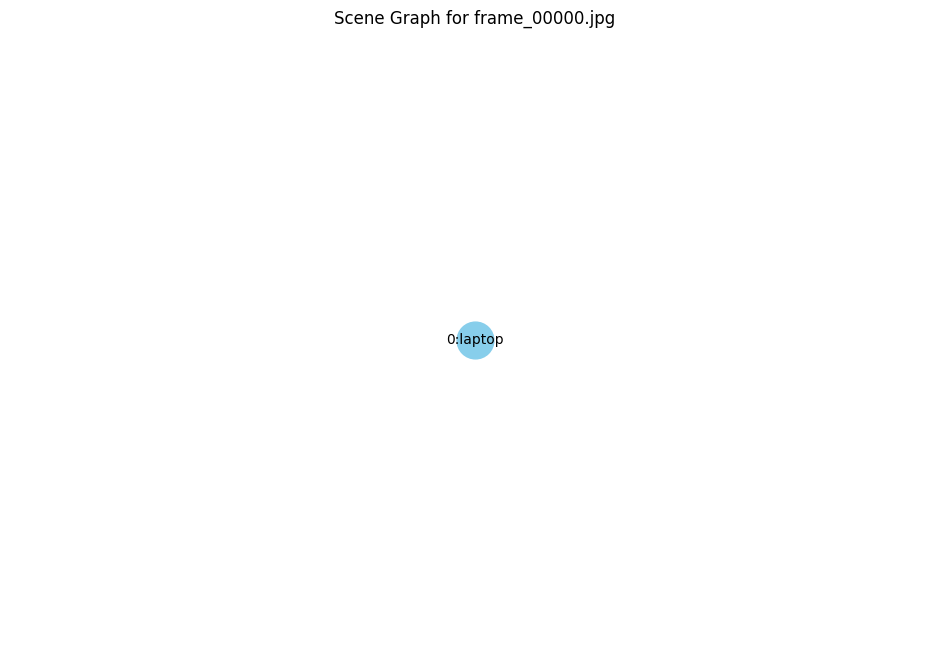

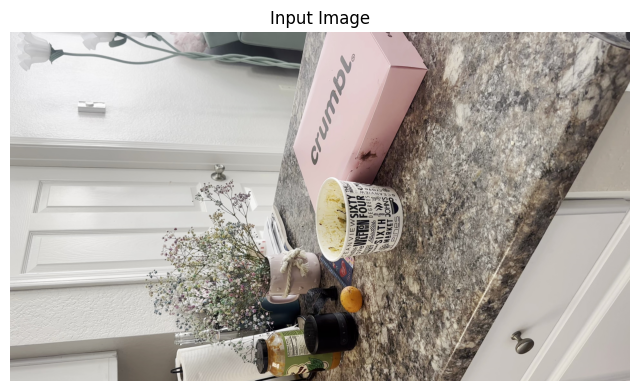


Processing frame: frame_00005.jpg
Boxes shape: (1, 4) Labels shape: (1,) Scores shape: (1,)


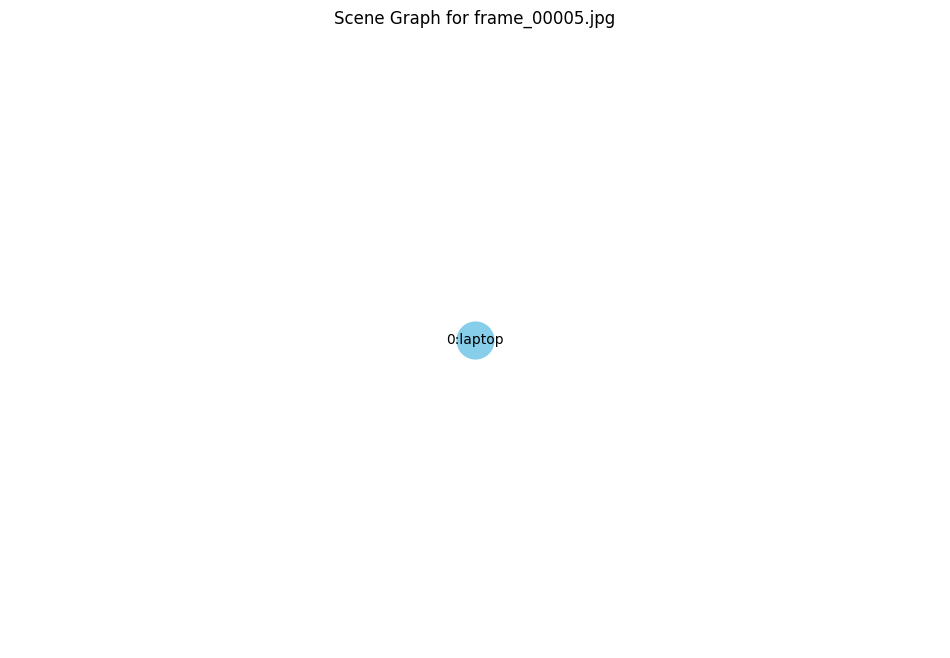

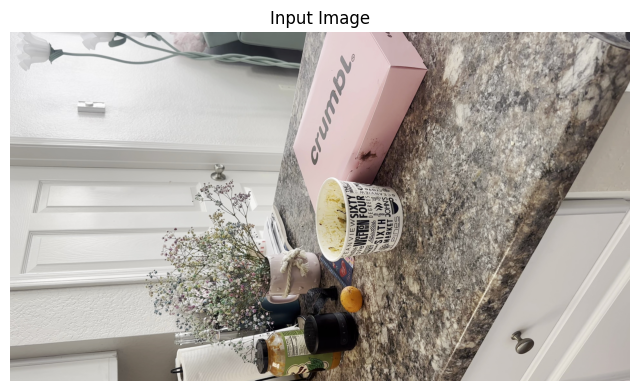


Processing frame: frame_00010.jpg
Boxes shape: (1, 4) Labels shape: (1,) Scores shape: (1,)


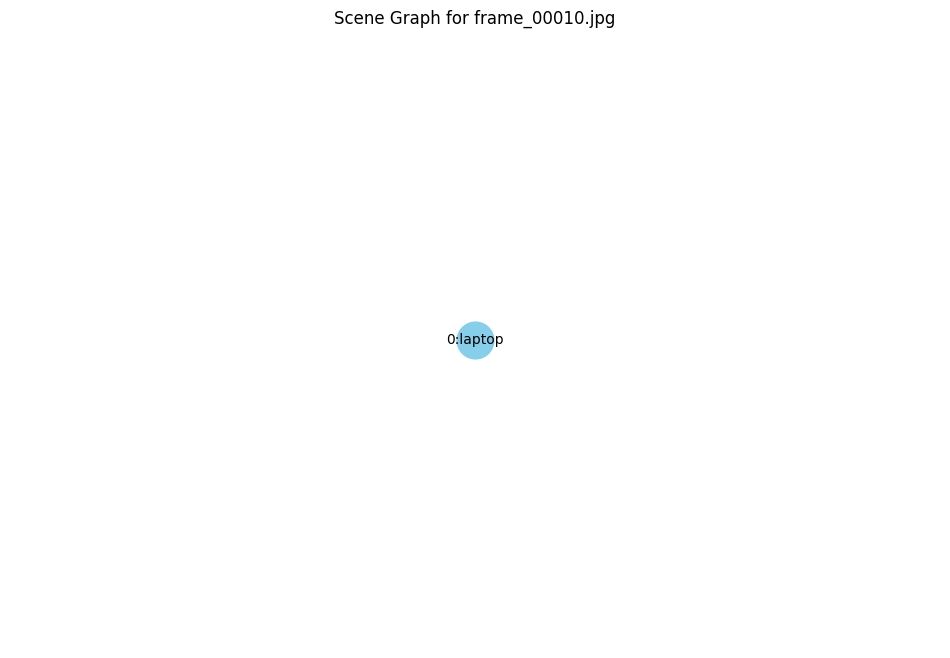

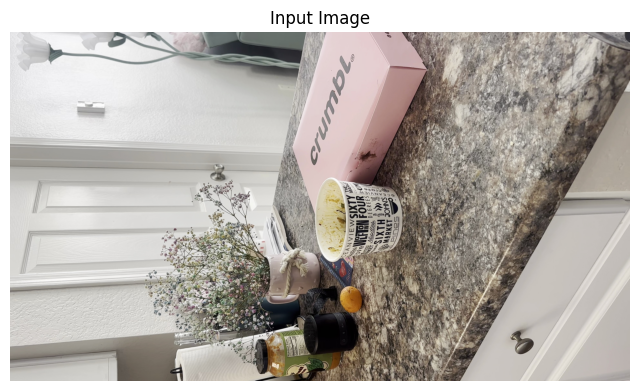


Processing frame: frame_00015.jpg
Boxes shape: (1, 4) Labels shape: (1,) Scores shape: (1,)


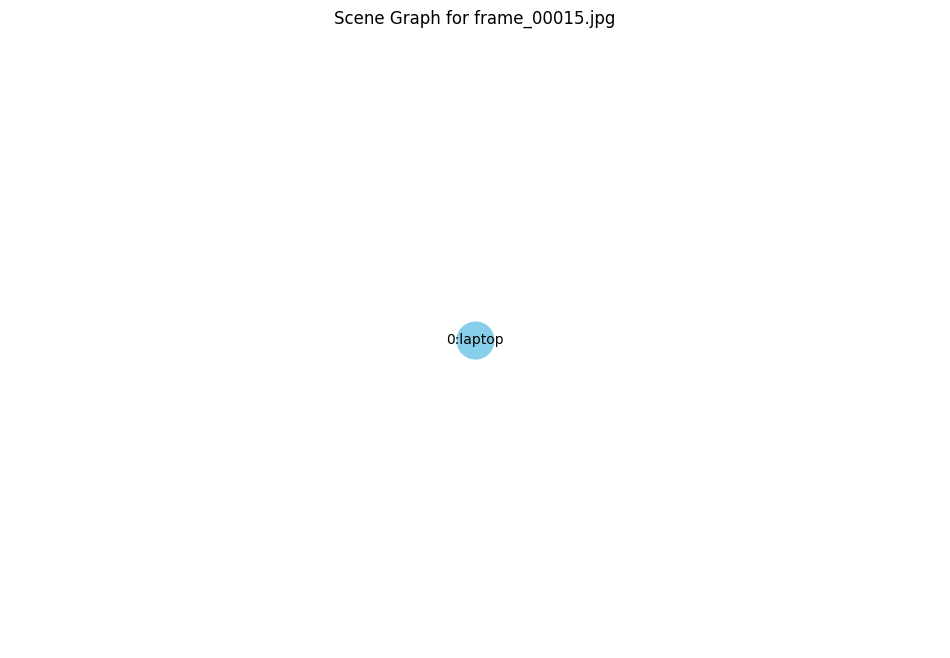

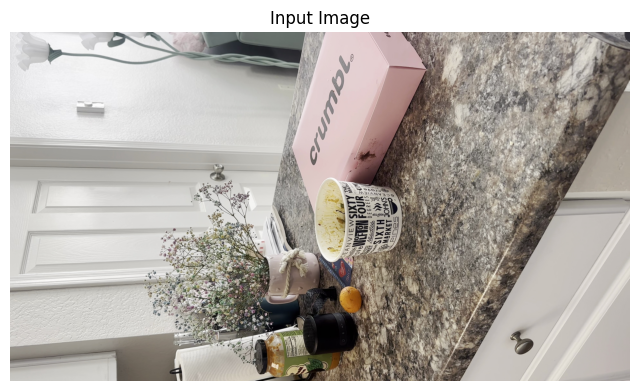


Processing frame: frame_00020.jpg
Boxes shape: (1, 4) Labels shape: (1,) Scores shape: (1,)


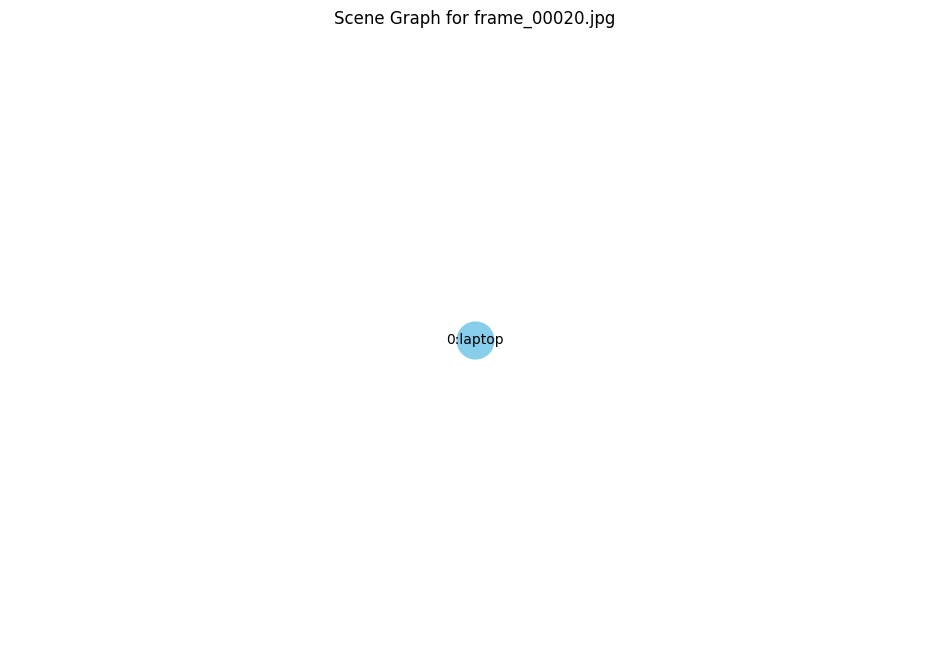

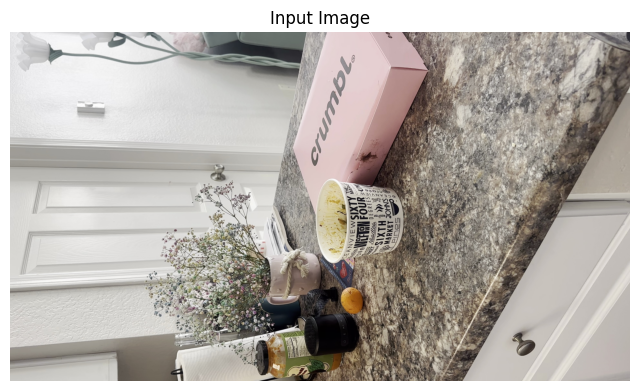


Processing frame: frame_00025.jpg
Boxes shape: (1, 4) Labels shape: (1,) Scores shape: (1,)


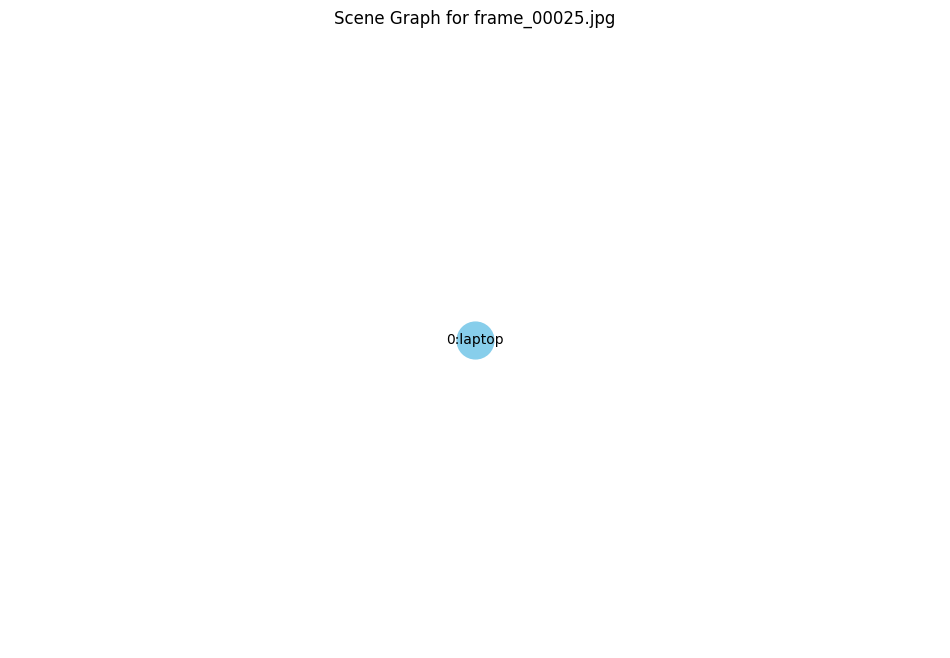

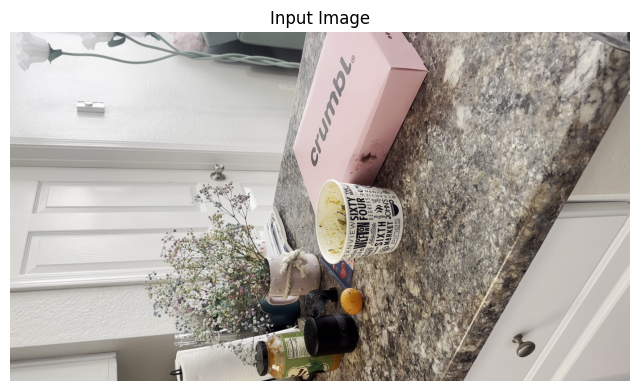


Processing frame: frame_00030.jpg
Boxes shape: (1, 4) Labels shape: (1,) Scores shape: (1,)


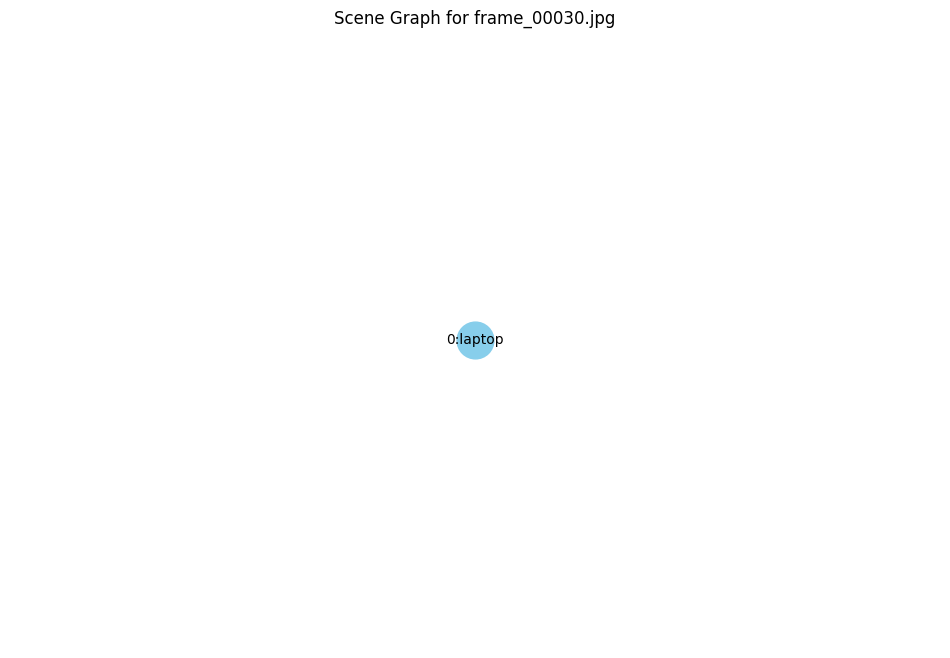

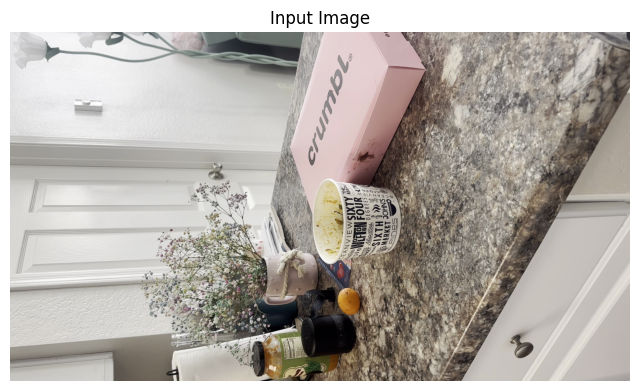


Processing frame: frame_00035.jpg
Boxes shape: (1, 4) Labels shape: (1,) Scores shape: (1,)


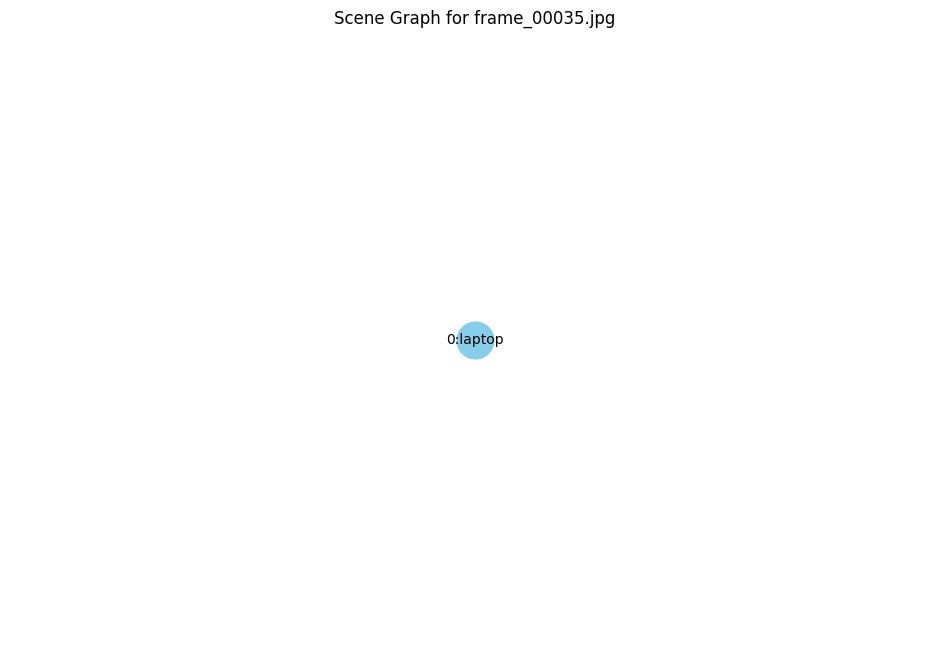

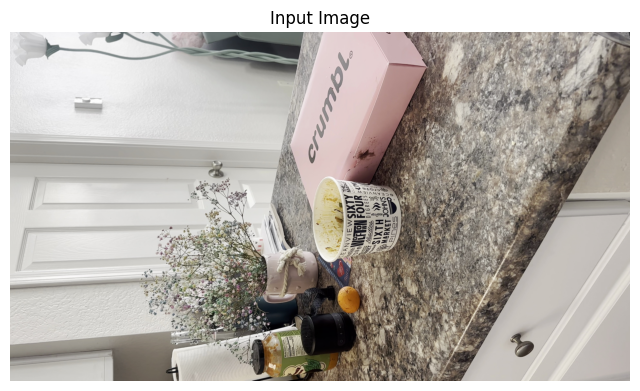


Processing frame: frame_00040.jpg
Boxes shape: (1, 4) Labels shape: (1,) Scores shape: (1,)


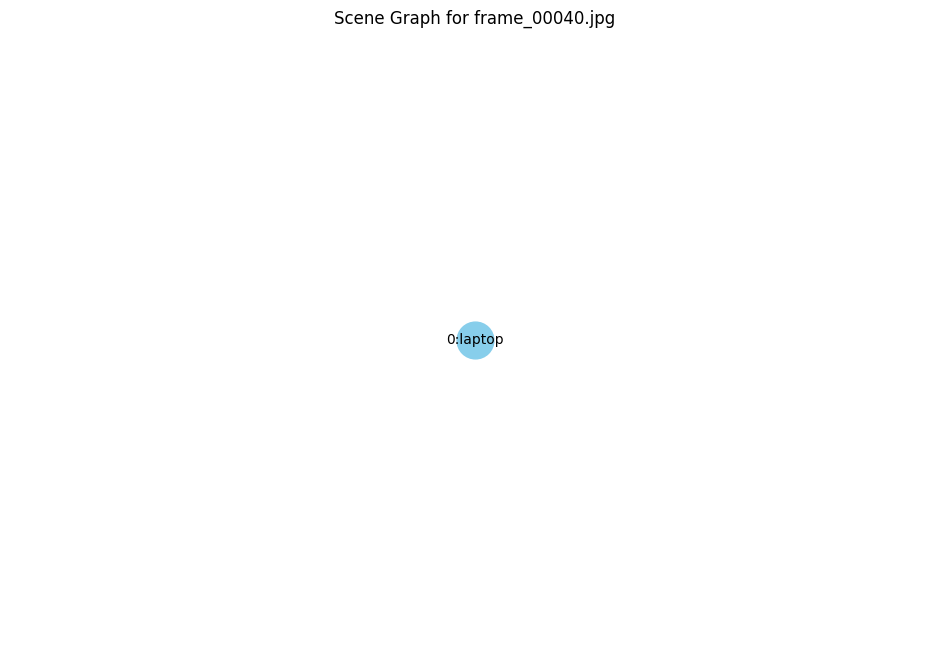

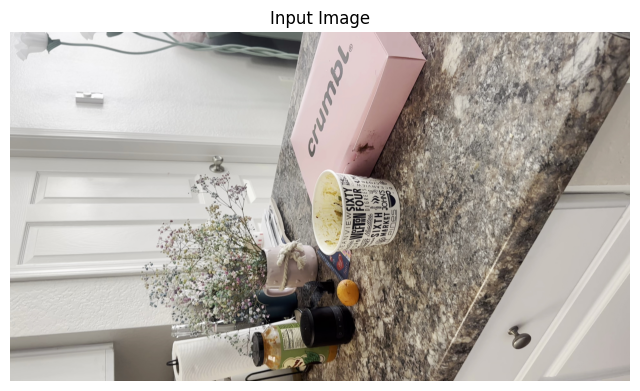


Processing frame: frame_00045.jpg
Boxes shape: (1, 4) Labels shape: (1,) Scores shape: (1,)


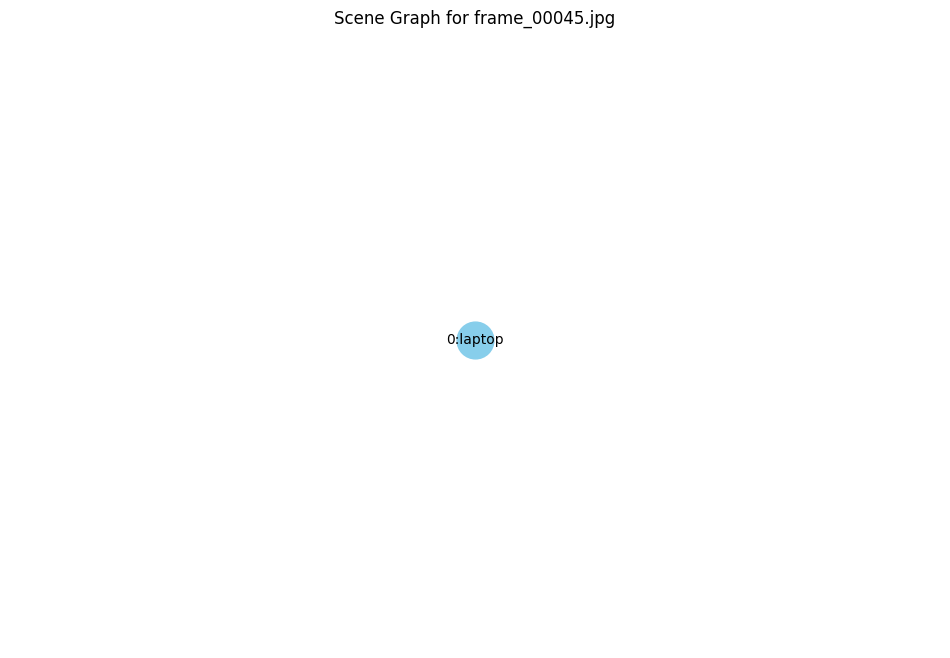

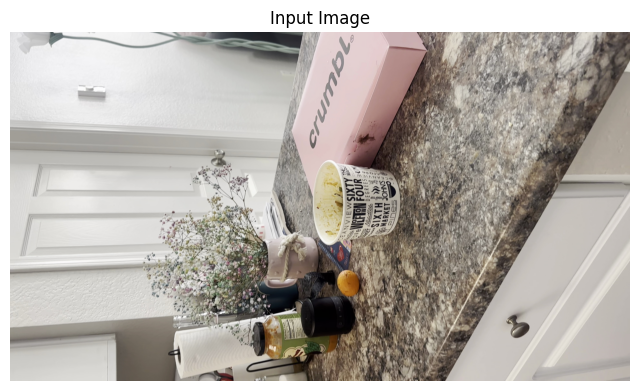


Processing frame: frame_00050.jpg
Boxes shape: (2, 4) Labels shape: (2,) Scores shape: (2,)


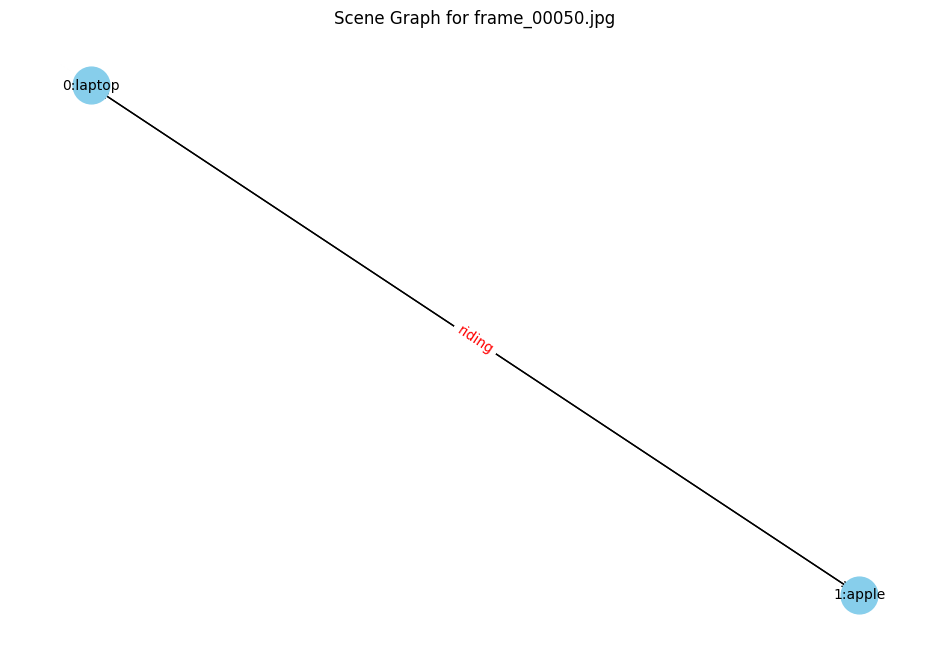

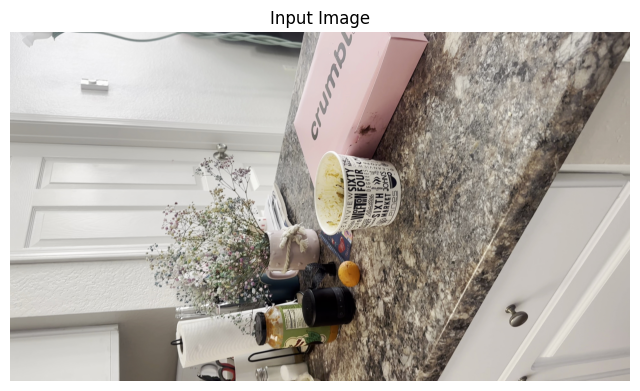


Processing frame: frame_00055.jpg
Boxes shape: (1, 4) Labels shape: (1,) Scores shape: (1,)


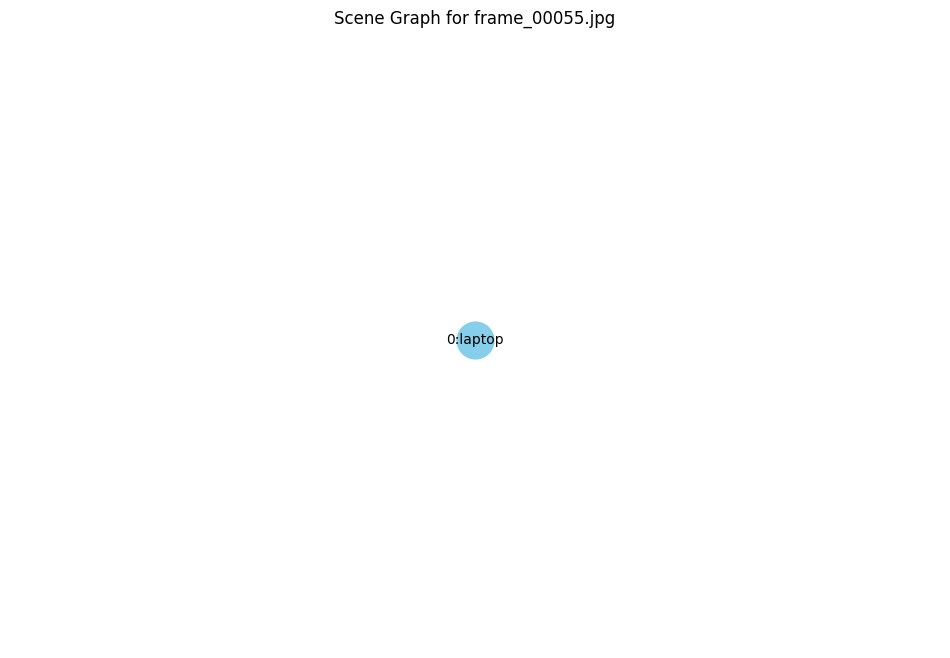

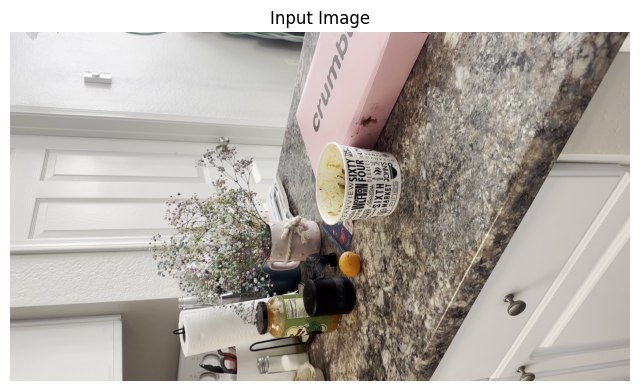


Processing frame: frame_00060.jpg
Boxes shape: (2, 4) Labels shape: (2,) Scores shape: (2,)


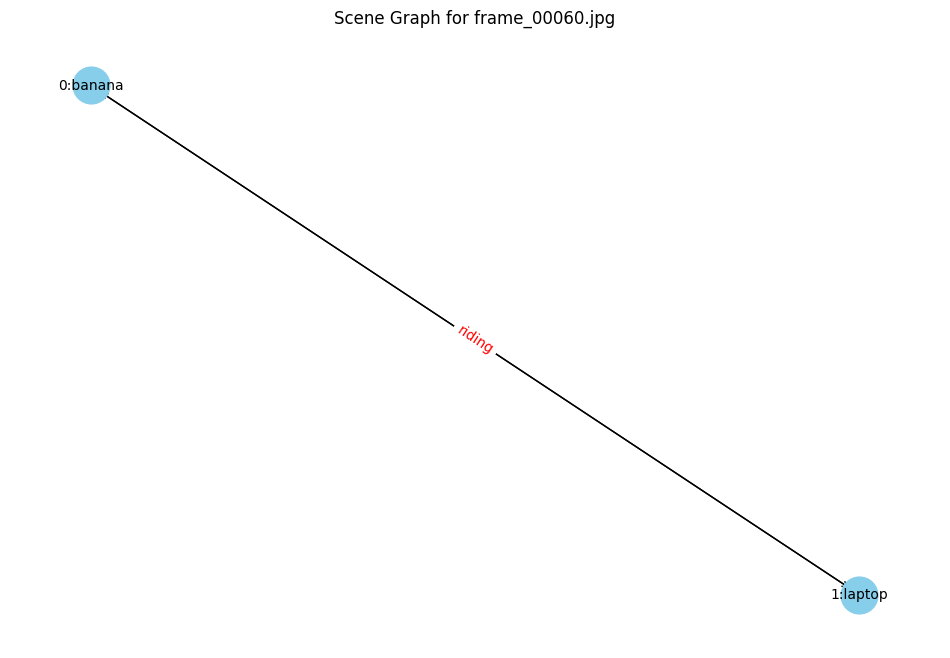

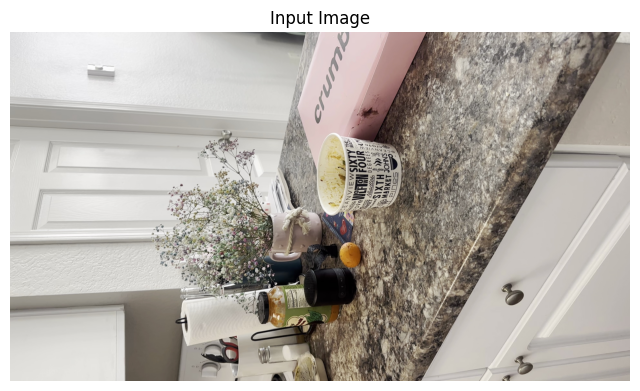


Processing frame: frame_00065.jpg
Boxes shape: (1, 4) Labels shape: (1,) Scores shape: (1,)


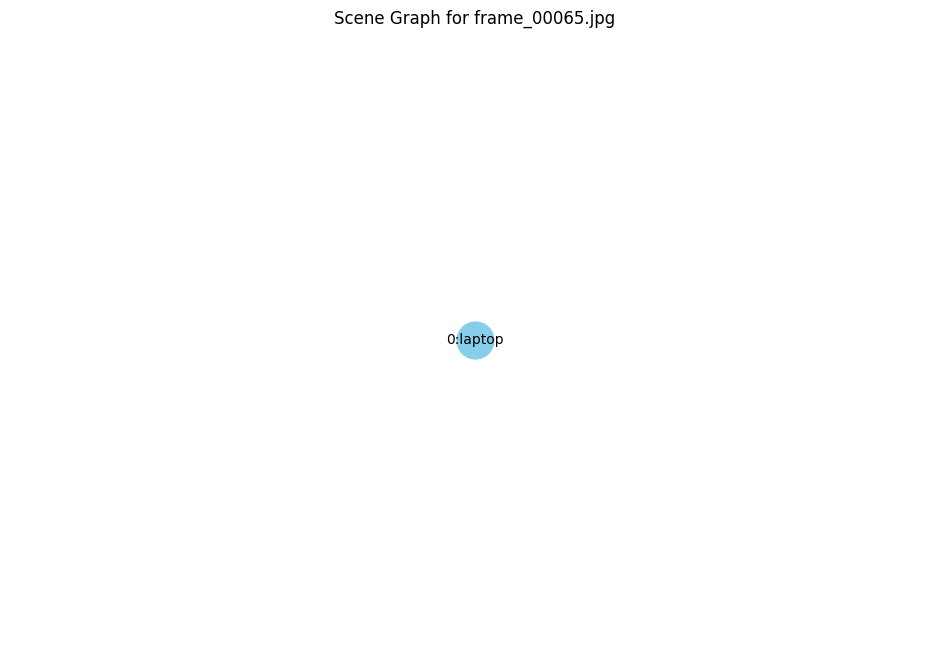

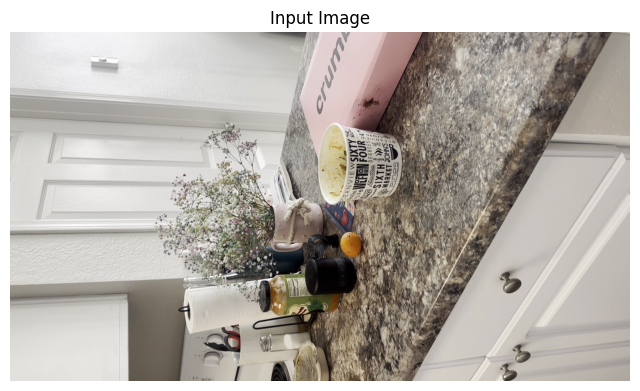


Processing frame: frame_00070.jpg
Boxes shape: (1, 4) Labels shape: (1,) Scores shape: (1,)


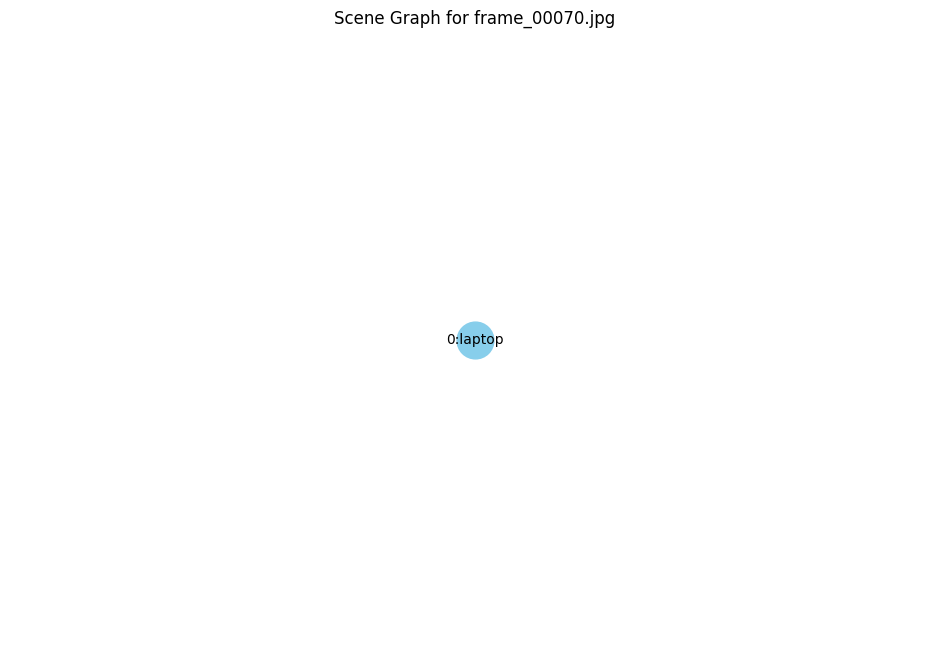

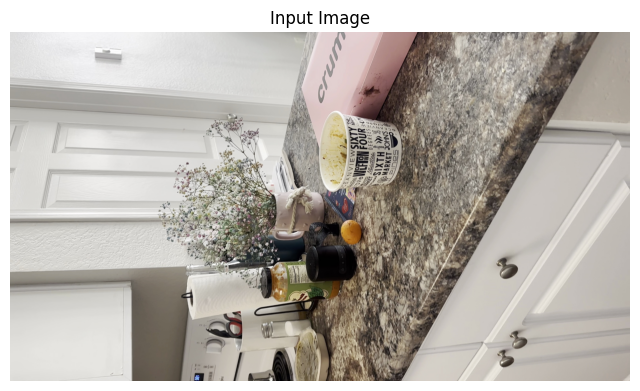


Processing frame: frame_00075.jpg
Boxes shape: (1, 4) Labels shape: (1,) Scores shape: (1,)


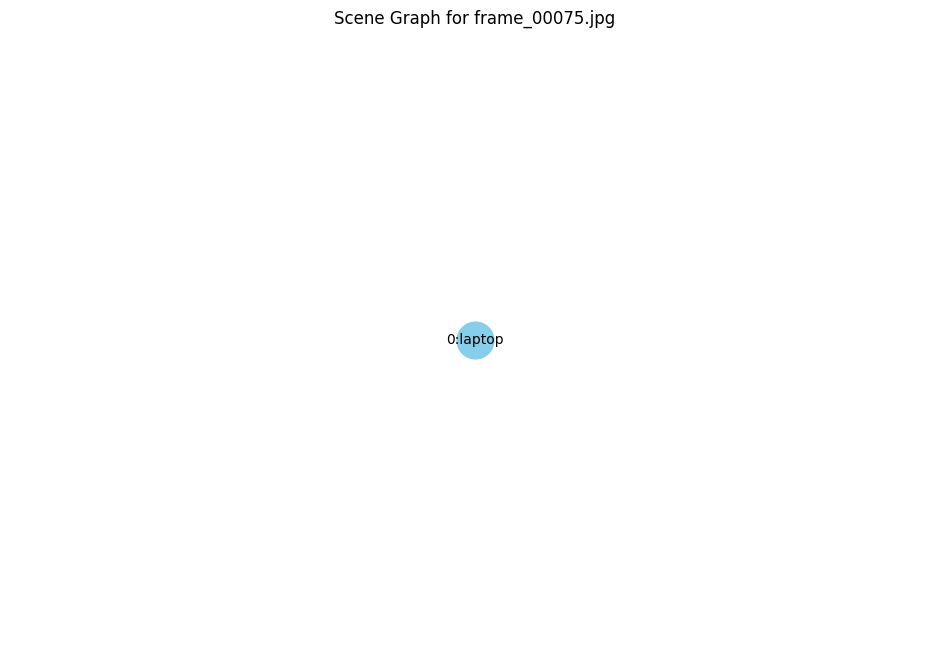

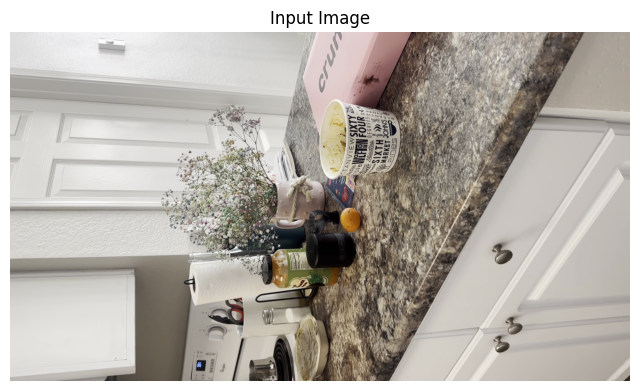


Processing frame: frame_00080.jpg
Boxes shape: (1, 4) Labels shape: (1,) Scores shape: (1,)


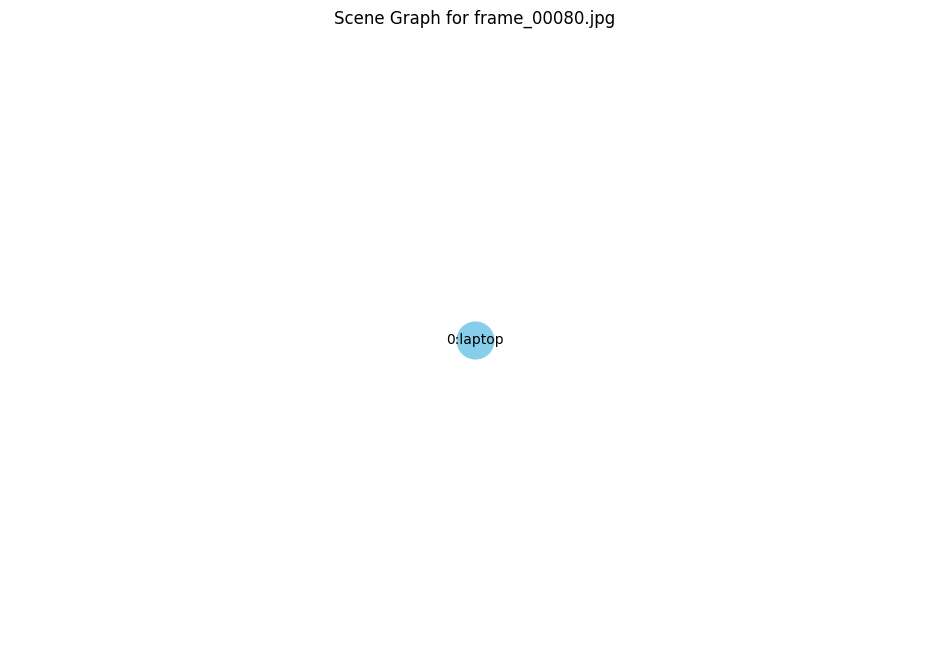

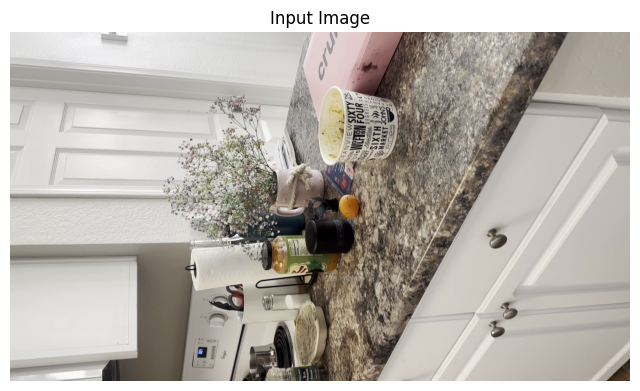


Processing frame: frame_00085.jpg
Boxes shape: (1, 4) Labels shape: (1,) Scores shape: (1,)


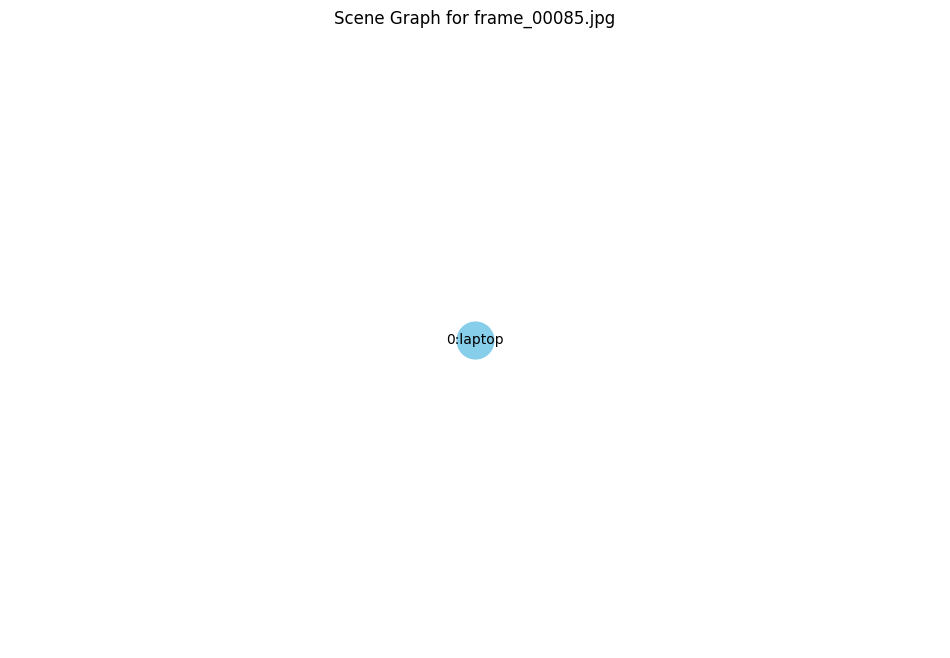

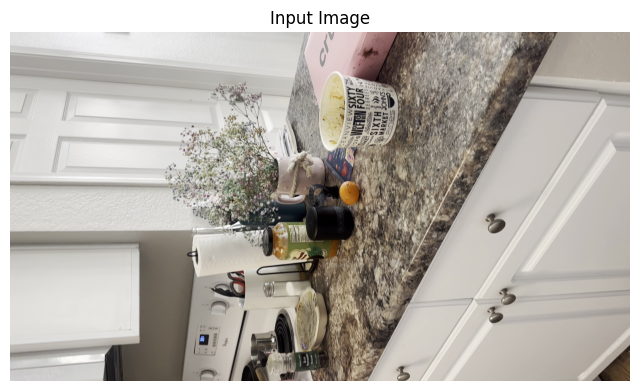


Processing frame: frame_00090.jpg
Boxes shape: (1, 4) Labels shape: (1,) Scores shape: (1,)


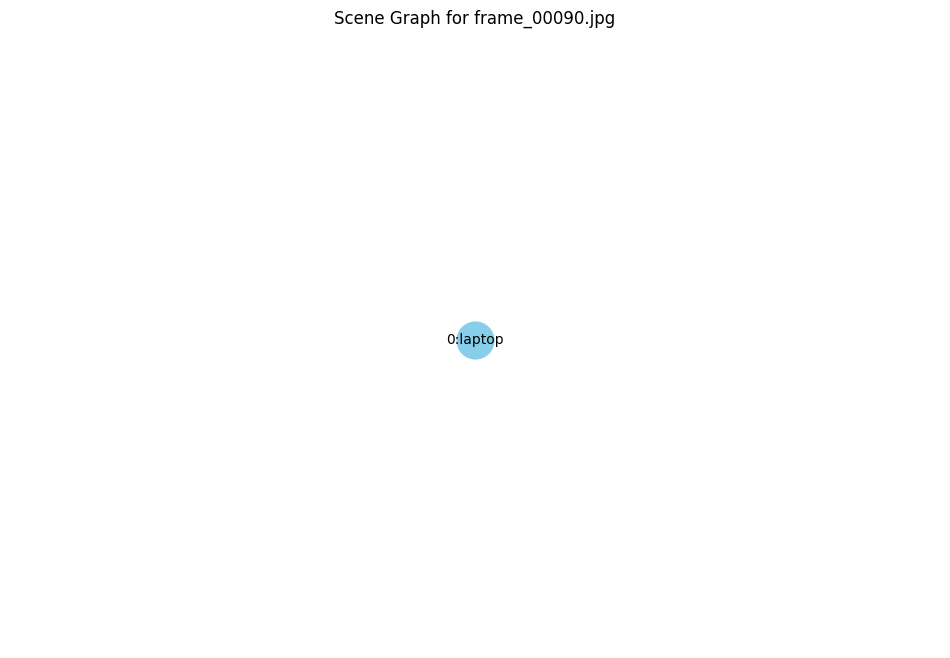

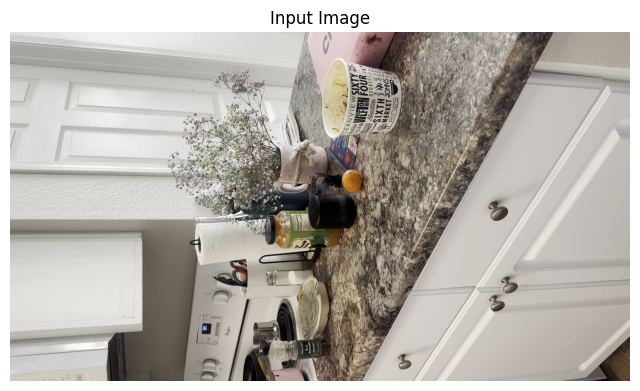


Processing frame: frame_00095.jpg
Boxes shape: (1, 4) Labels shape: (1,) Scores shape: (1,)


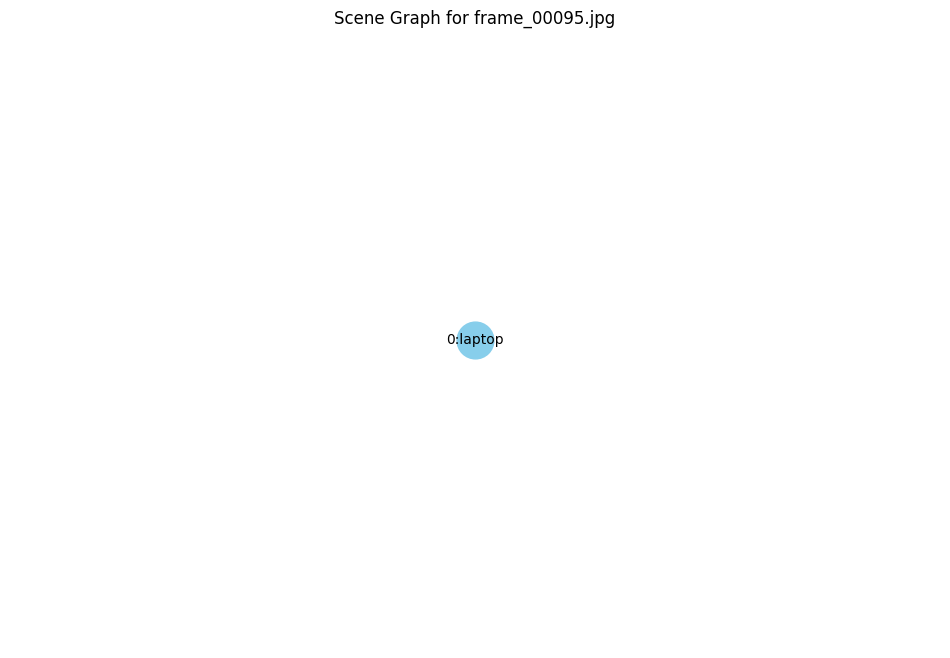

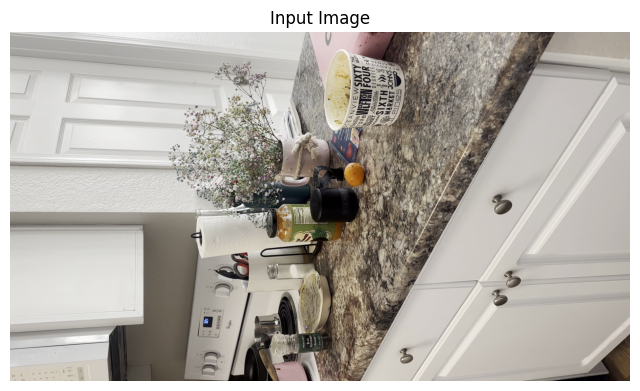


Processing frame: frame_00100.jpg
Boxes shape: (1, 4) Labels shape: (1,) Scores shape: (1,)


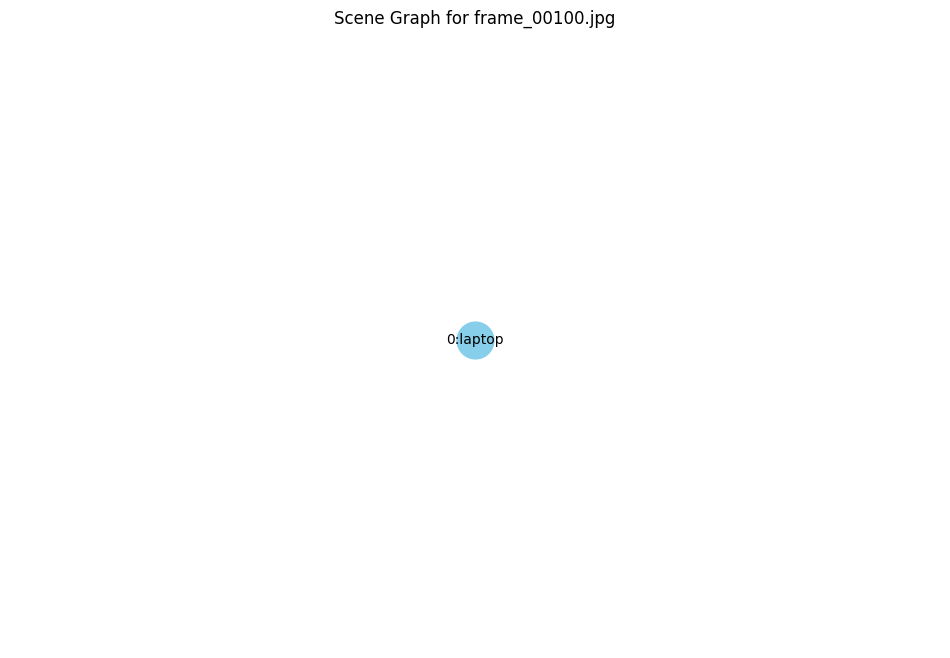

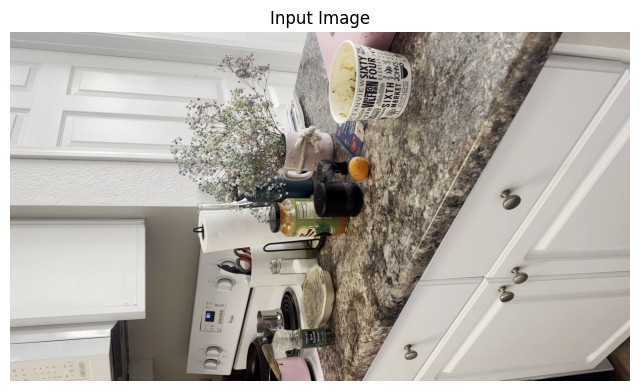


Processing frame: frame_00105.jpg
Boxes shape: (2, 4) Labels shape: (2,) Scores shape: (2,)


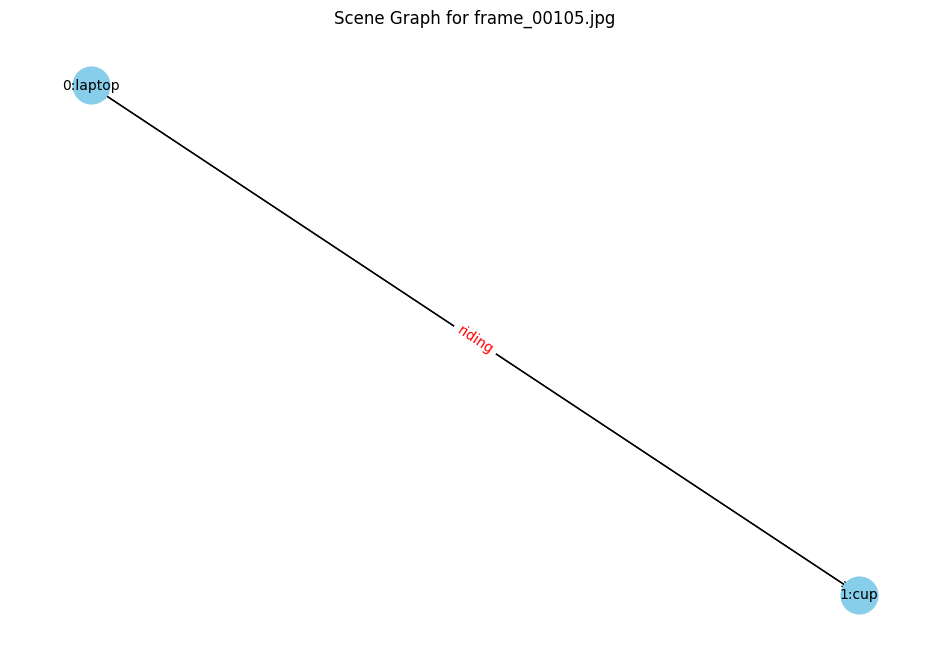

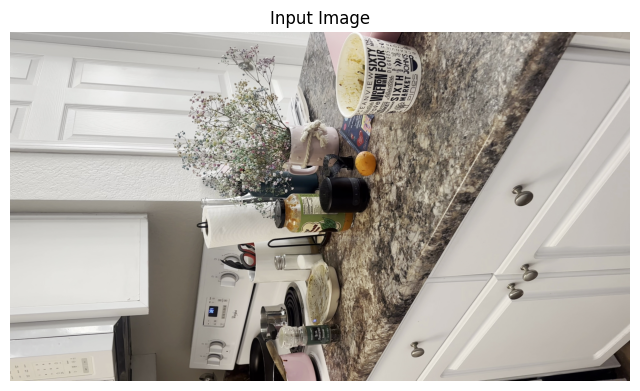


Processing frame: frame_00110.jpg
Boxes shape: (1, 4) Labels shape: (1,) Scores shape: (1,)


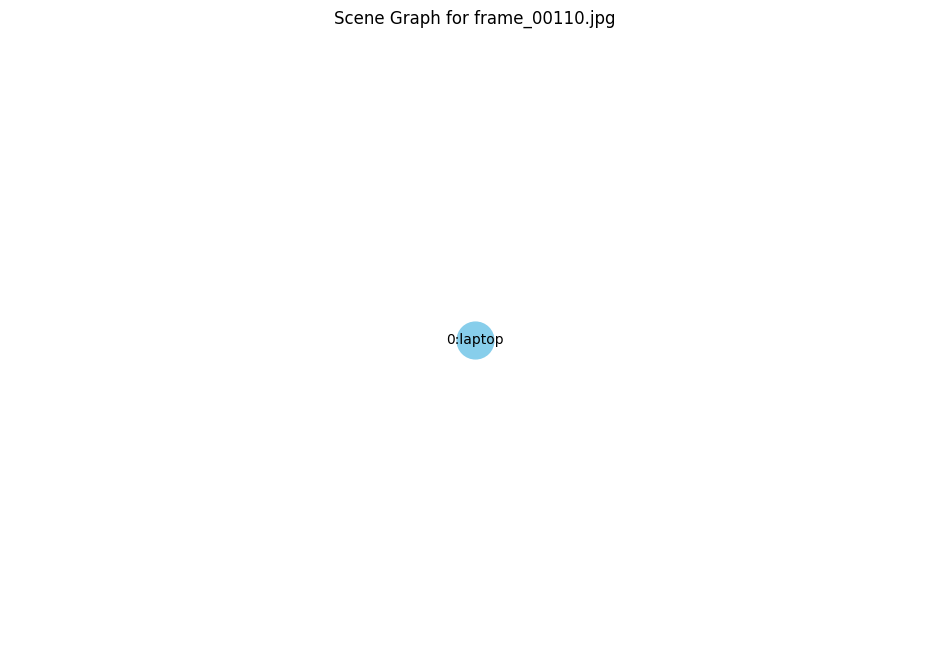

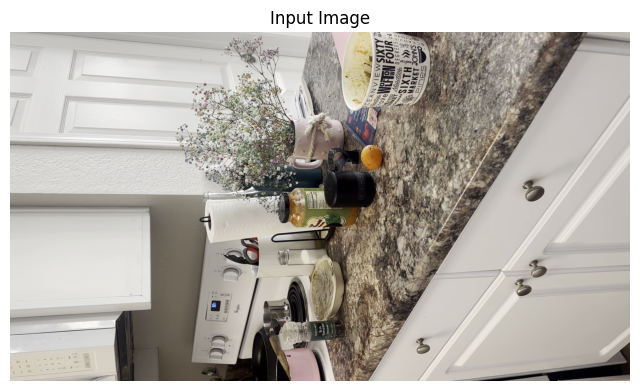


Processing frame: frame_00115.jpg
Boxes shape: (1, 4) Labels shape: (1,) Scores shape: (1,)


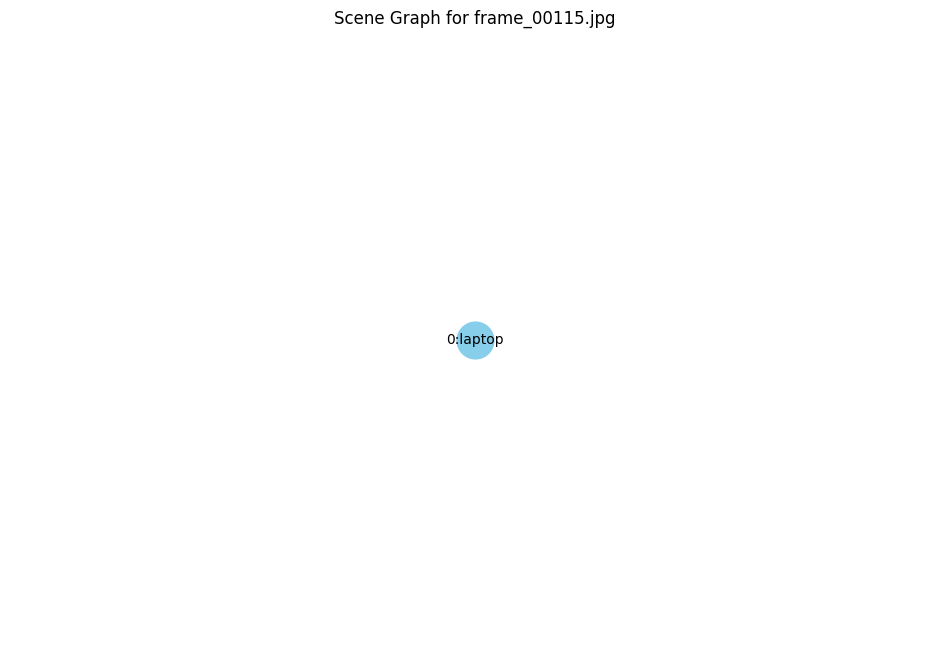

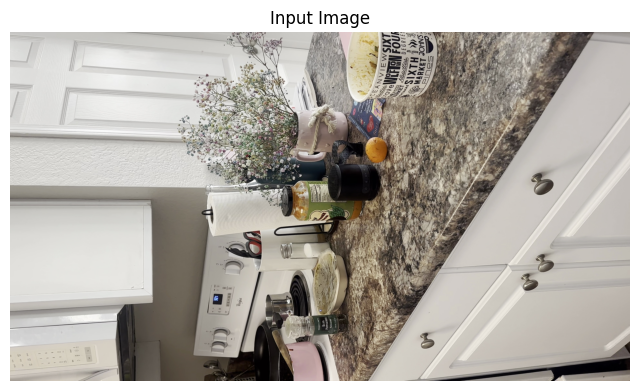


Processing frame: frame_00120.jpg
No detections in frame_00120.jpg, skipping.

Processing frame: frame_00125.jpg
Boxes shape: (2, 4) Labels shape: (2,) Scores shape: (2,)
Error processing frame_00125.jpg: 'label'

Processing frame: frame_00130.jpg
No detections in frame_00130.jpg, skipping.

Processing frame: frame_00135.jpg
No detections in frame_00135.jpg, skipping.

Processing frame: frame_00140.jpg
Boxes shape: (1, 4) Labels shape: (1,) Scores shape: (1,)


<Figure size 1200x800 with 0 Axes>

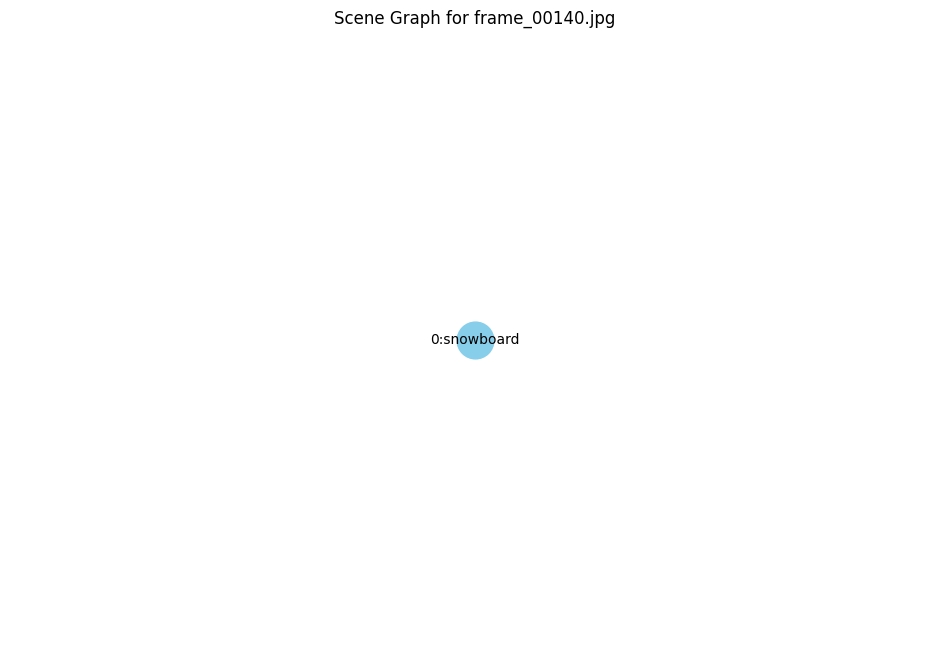

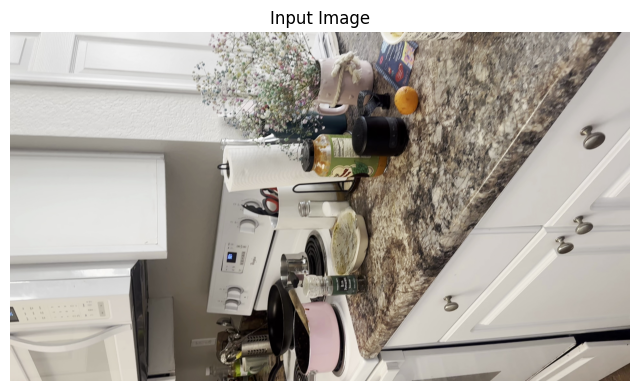


Processing frame: frame_00145.jpg
No detections in frame_00145.jpg, skipping.

Processing frame: frame_00150.jpg
Boxes shape: (1, 4) Labels shape: (1,) Scores shape: (1,)


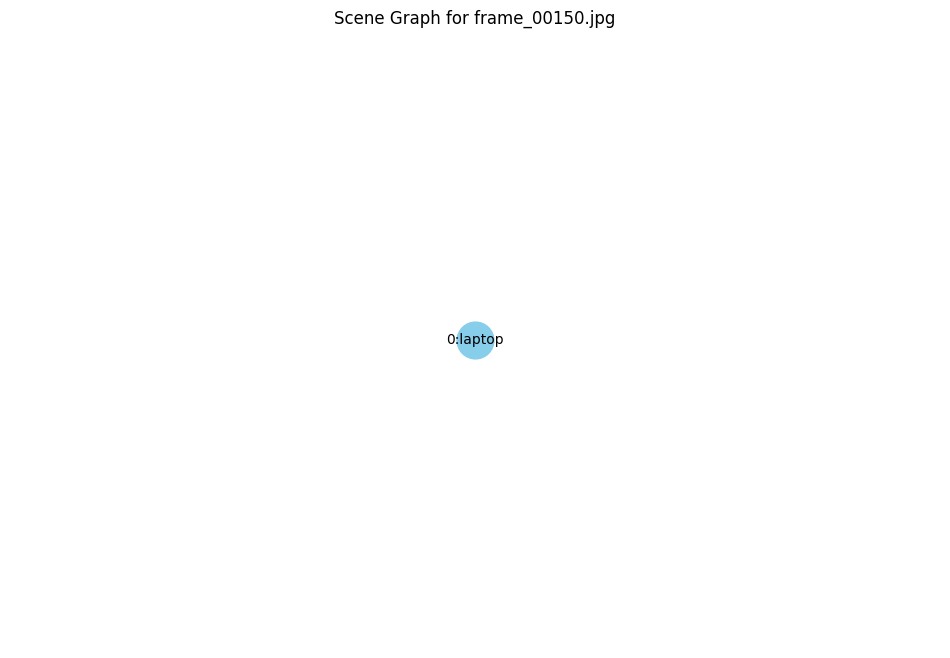

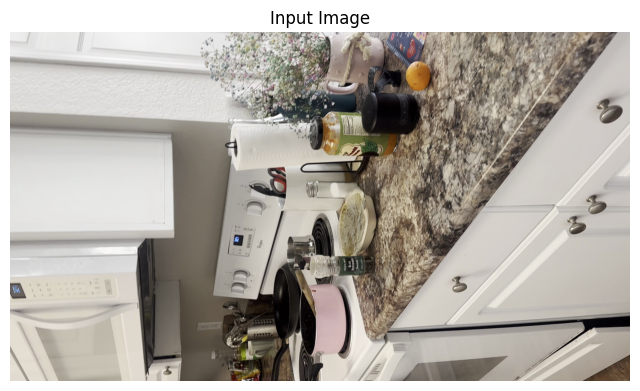


Processing frame: frame_00155.jpg
No detections in frame_00155.jpg, skipping.

Processing frame: frame_00160.jpg
Boxes shape: (1, 4) Labels shape: (1,) Scores shape: (1,)


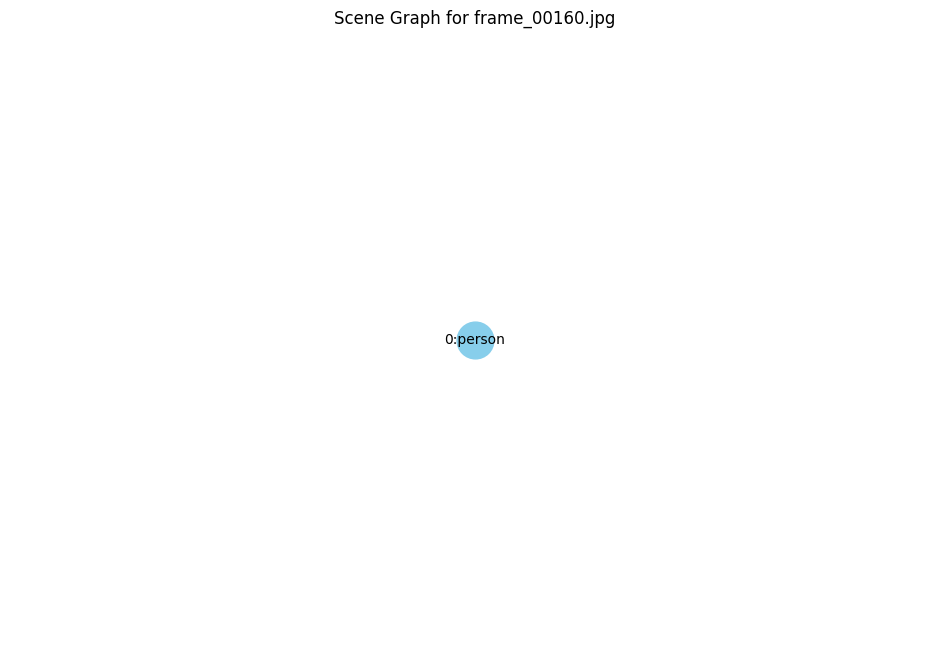

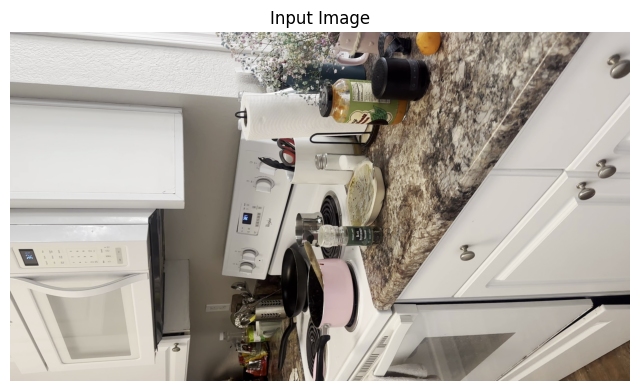


Processing frame: frame_00165.jpg
No detections in frame_00165.jpg, skipping.

Processing frame: frame_00170.jpg
No detections in frame_00170.jpg, skipping.

Processing frame: frame_00175.jpg
No detections in frame_00175.jpg, skipping.

Processing frame: frame_00180.jpg
No detections in frame_00180.jpg, skipping.

Processing frame: frame_00185.jpg
Boxes shape: (1, 4) Labels shape: (1,) Scores shape: (1,)


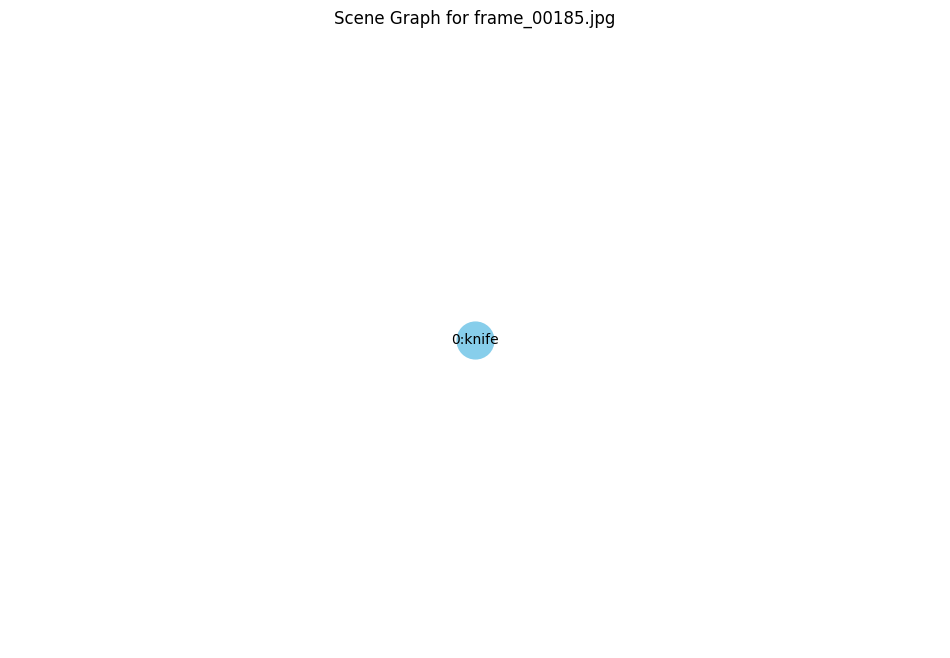

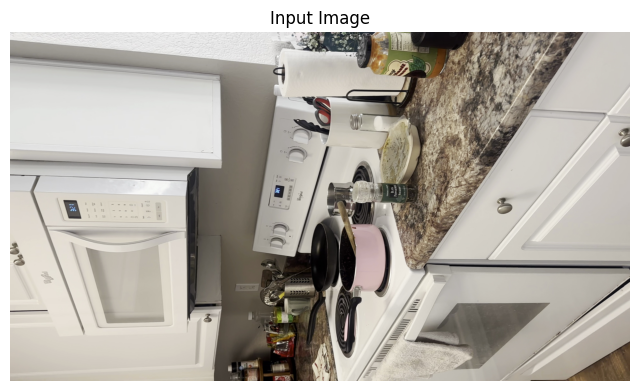


Processing frame: frame_00190.jpg
No detections in frame_00190.jpg, skipping.

Processing frame: frame_00195.jpg
Boxes shape: (1, 4) Labels shape: (1,) Scores shape: (1,)


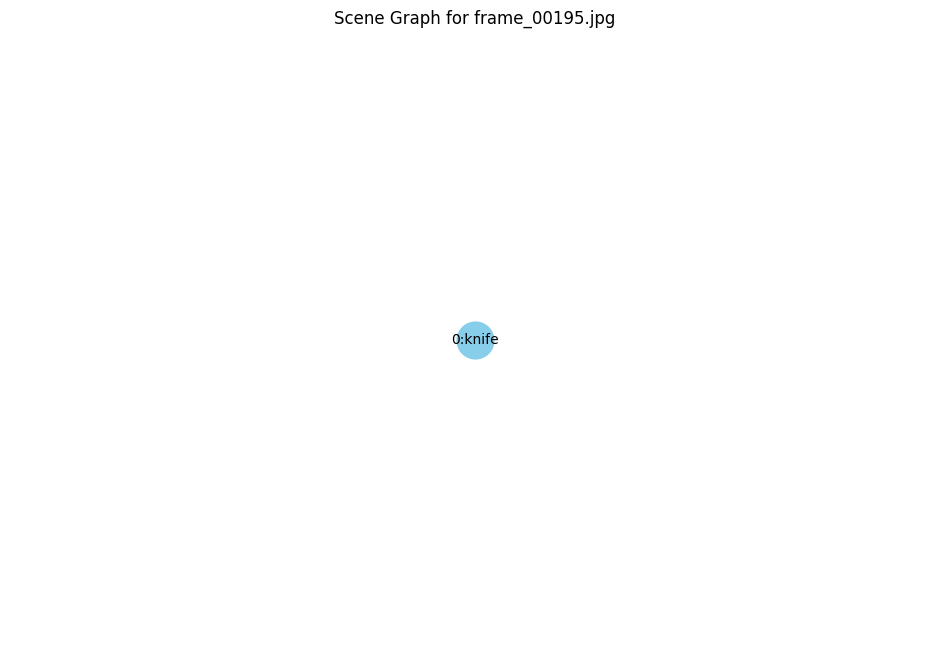

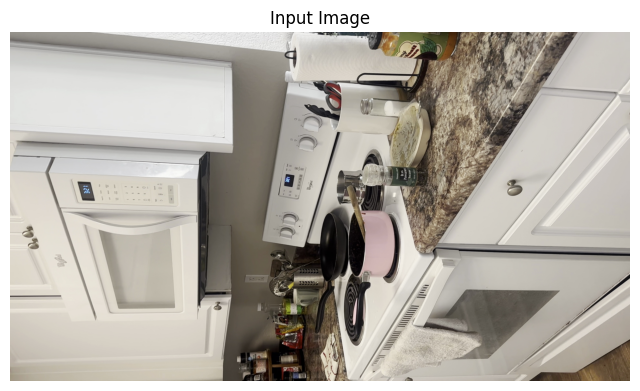


Processing frame: frame_00200.jpg
No detections in frame_00200.jpg, skipping.

Processing frame: frame_00205.jpg
No detections in frame_00205.jpg, skipping.

Processing frame: frame_00210.jpg
No detections in frame_00210.jpg, skipping.

Processing frame: frame_00215.jpg
Boxes shape: (1, 4) Labels shape: (1,) Scores shape: (1,)


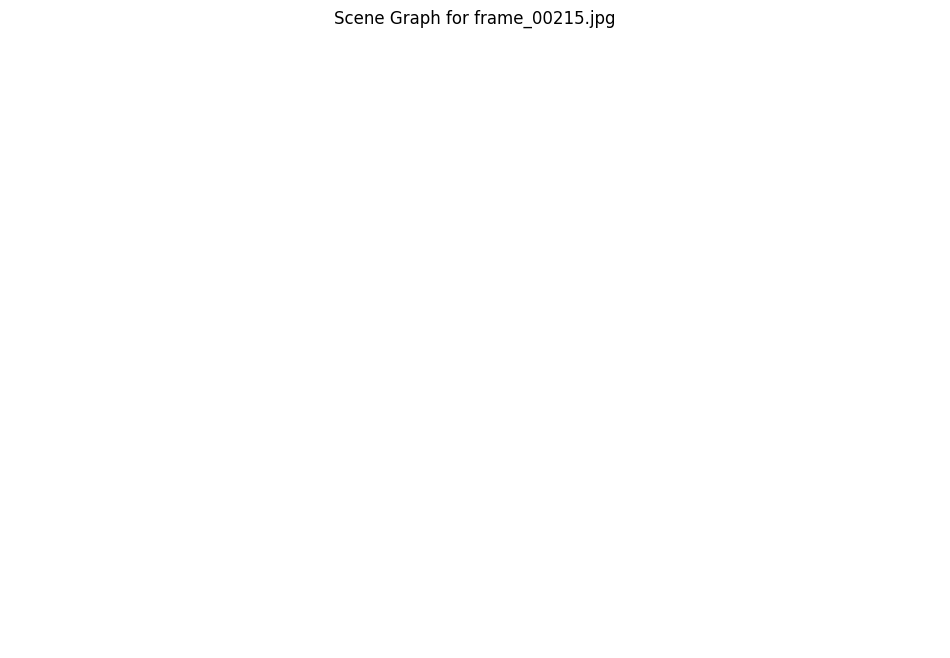

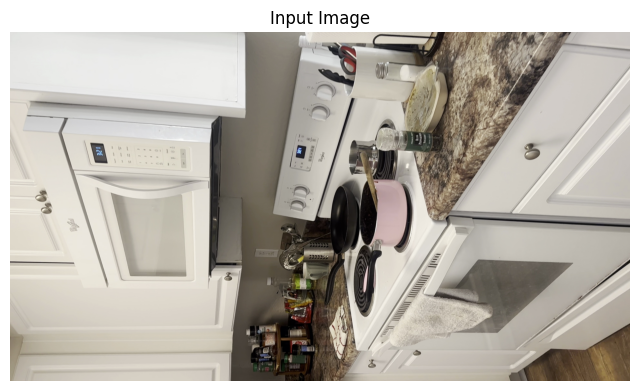


Processing frame: frame_00220.jpg
No detections in frame_00220.jpg, skipping.

Processing frame: frame_00225.jpg
No detections in frame_00225.jpg, skipping.

Processing frame: frame_00230.jpg
Boxes shape: (1, 4) Labels shape: (1,) Scores shape: (1,)


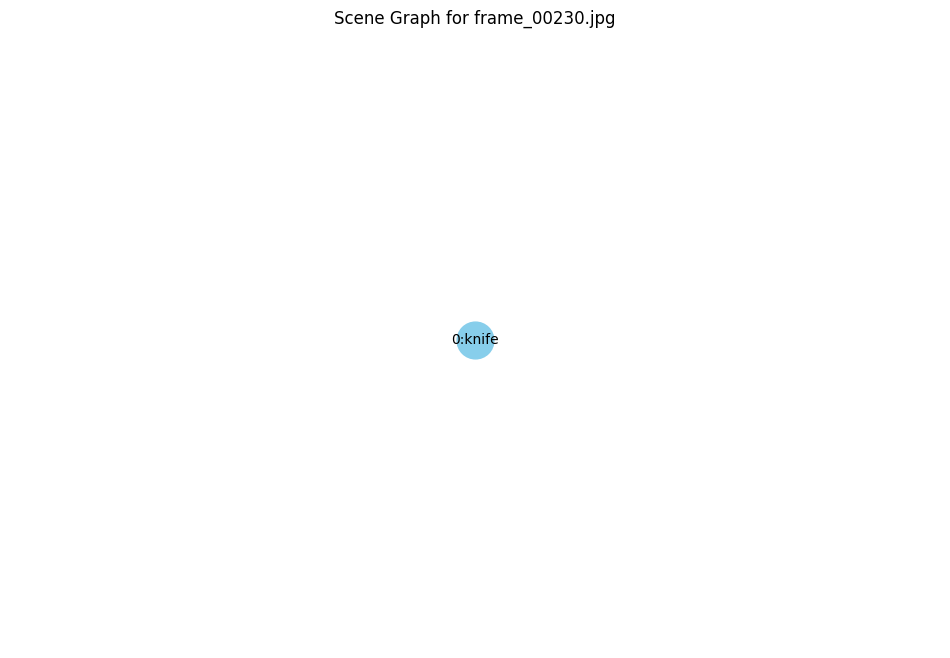

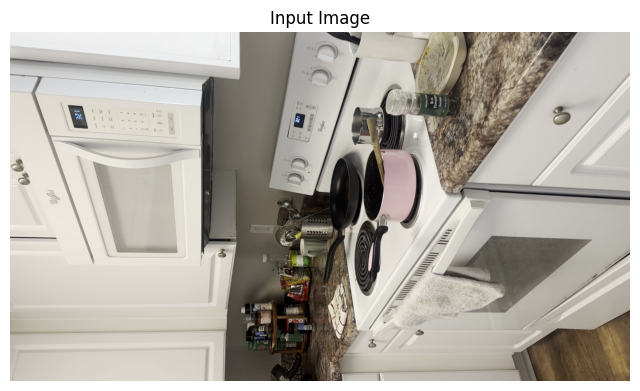


Processing frame: frame_00235.jpg
Boxes shape: (1, 4) Labels shape: (1,) Scores shape: (1,)


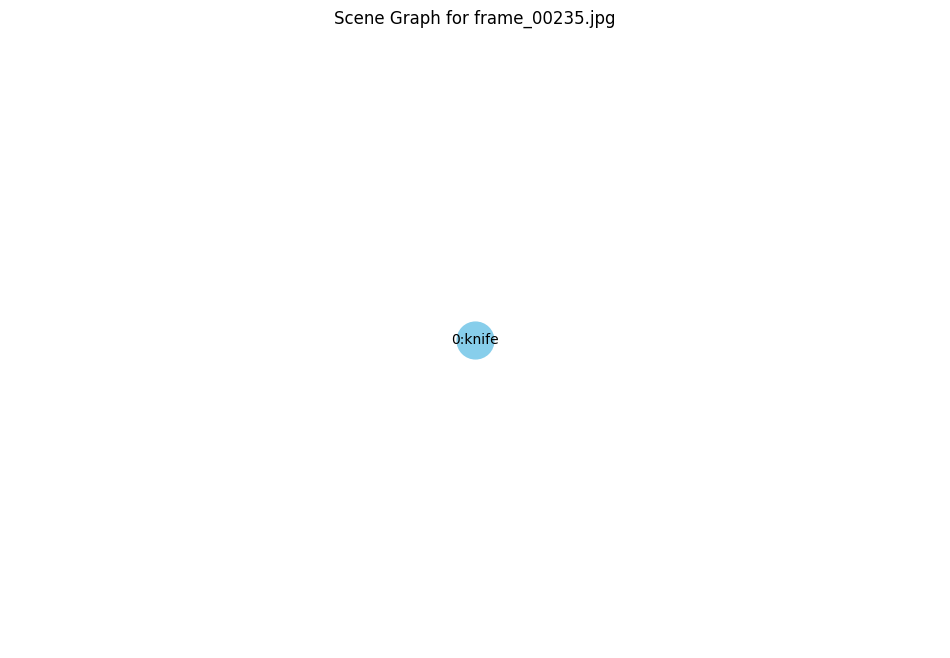

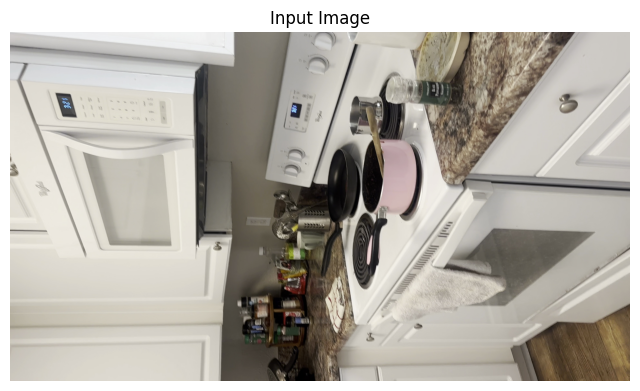


Processing frame: frame_00240.jpg
Boxes shape: (3, 4) Labels shape: (3,) Scores shape: (3,)


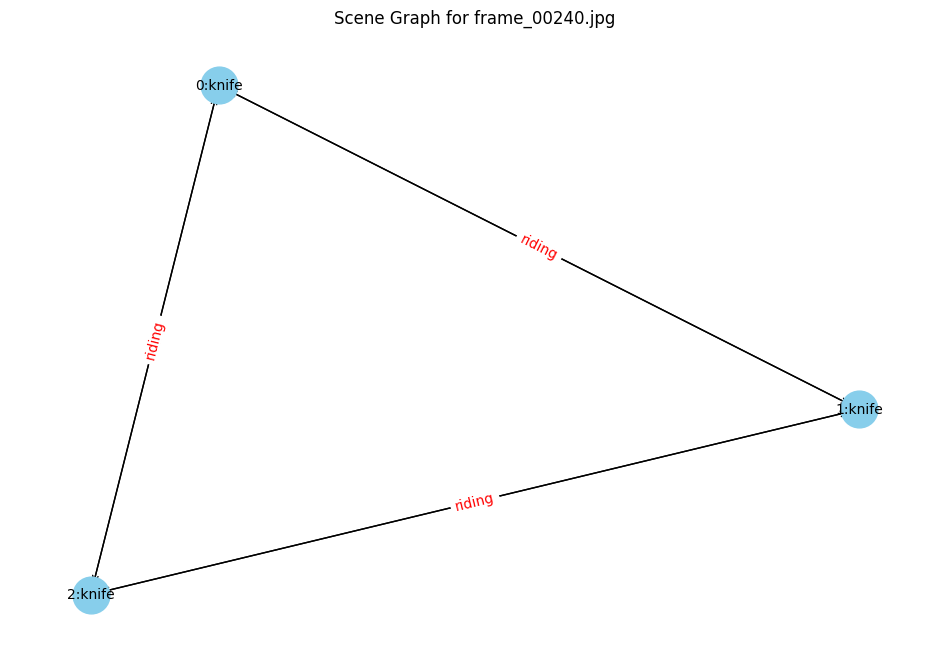

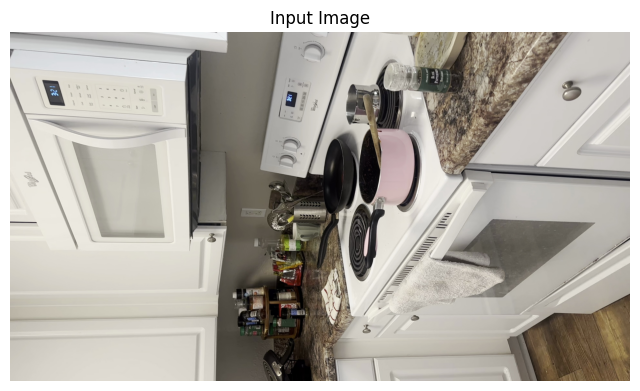


Processing frame: frame_00245.jpg
Boxes shape: (2, 4) Labels shape: (2,) Scores shape: (2,)


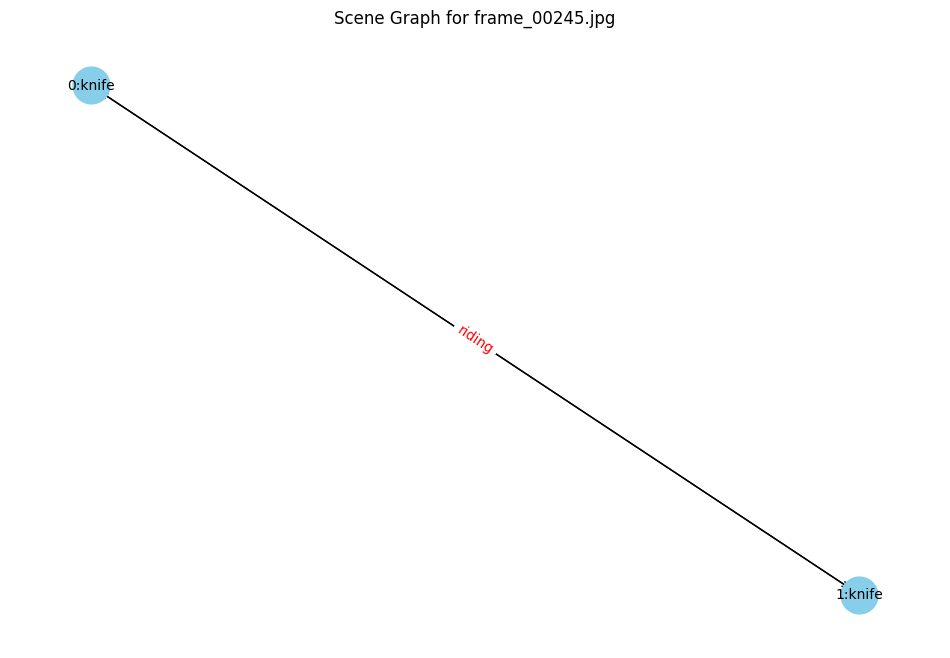

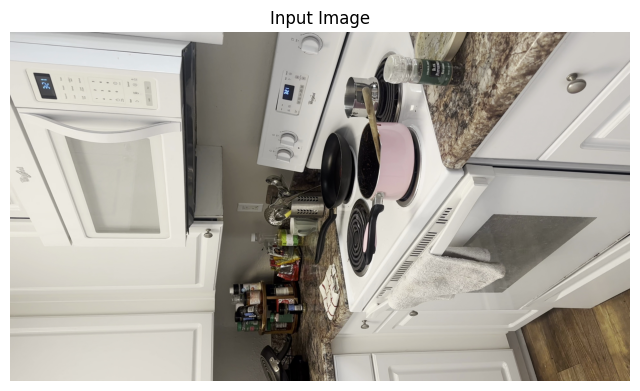


Processing frame: frame_00250.jpg
Boxes shape: (1, 4) Labels shape: (1,) Scores shape: (1,)


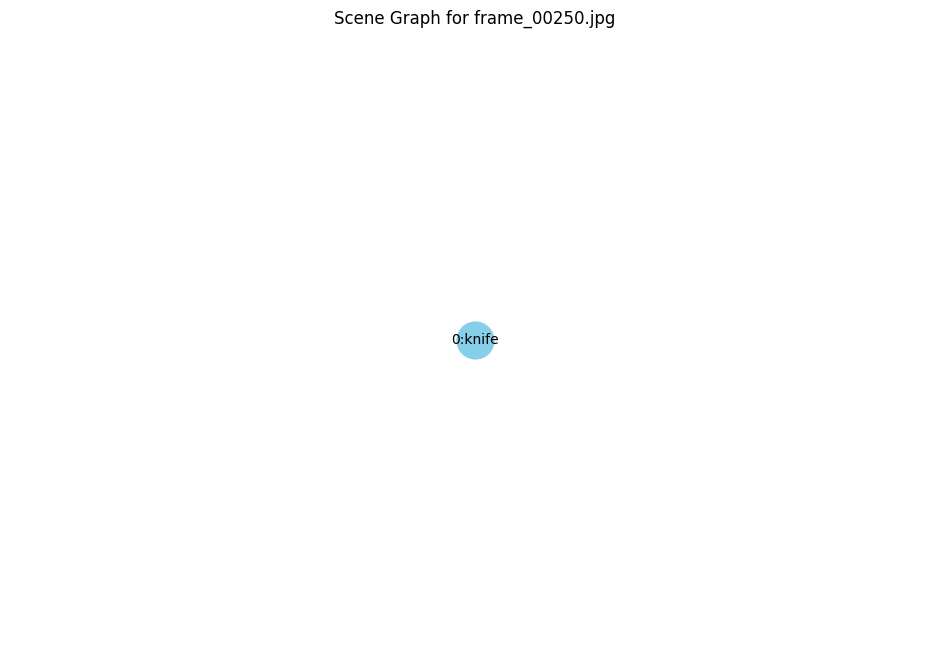

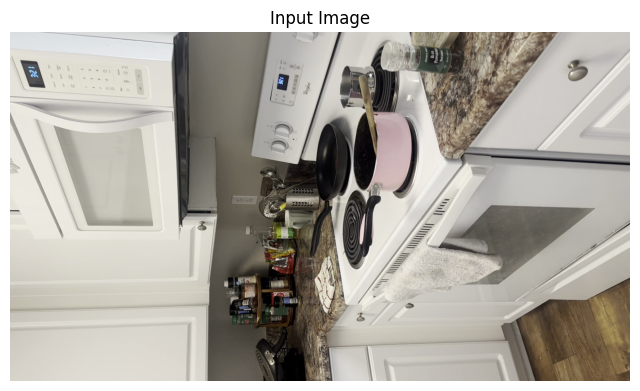


Processing frame: frame_00255.jpg
Boxes shape: (1, 4) Labels shape: (1,) Scores shape: (1,)


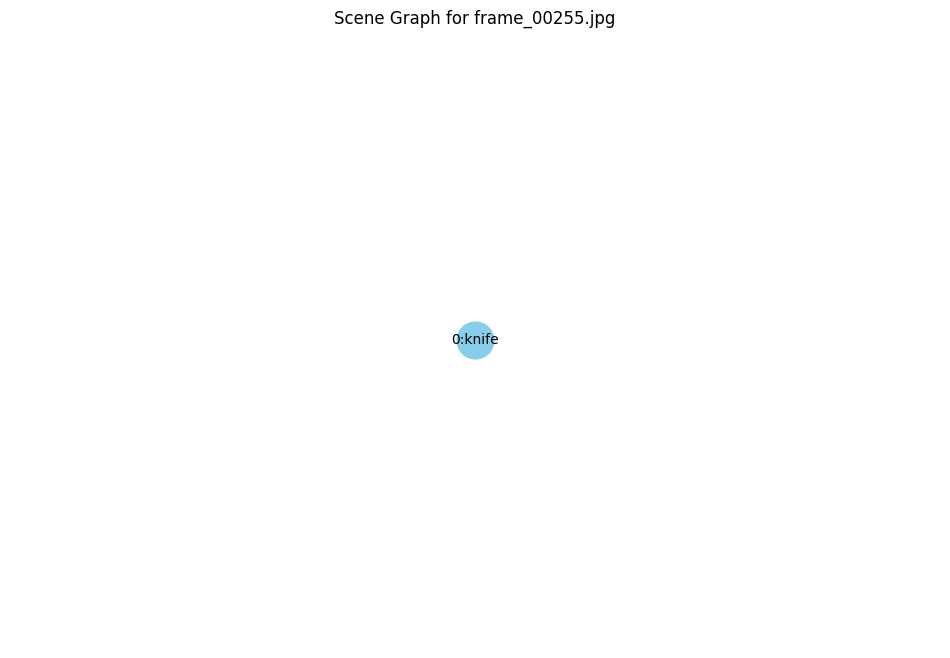

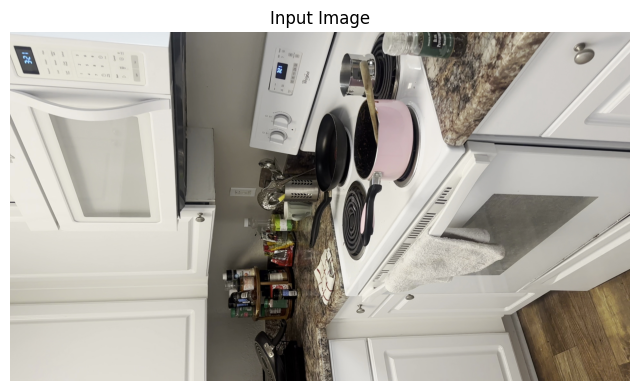


Processing frame: frame_00260.jpg
Boxes shape: (1, 4) Labels shape: (1,) Scores shape: (1,)


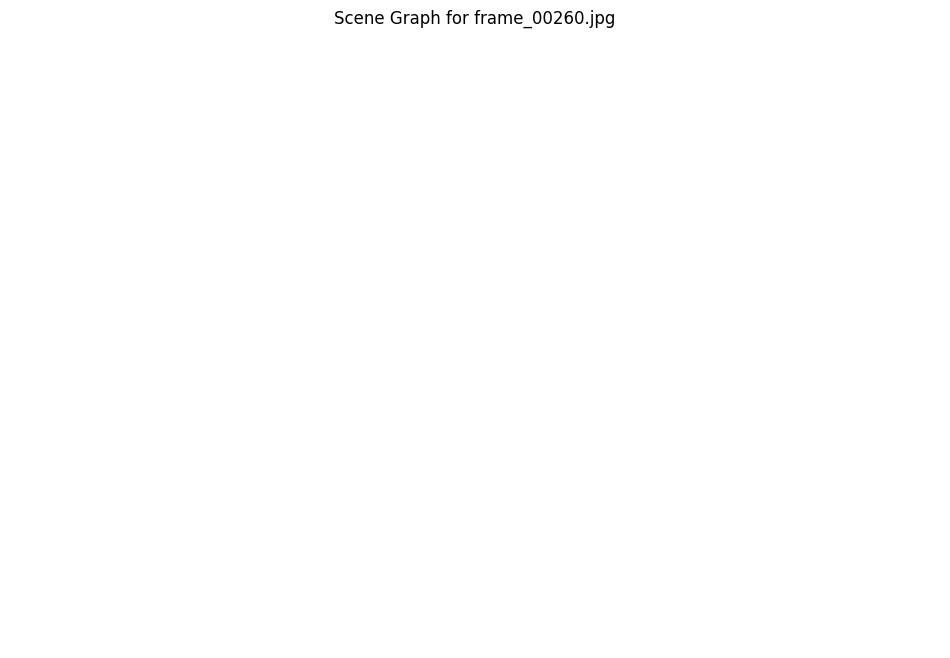

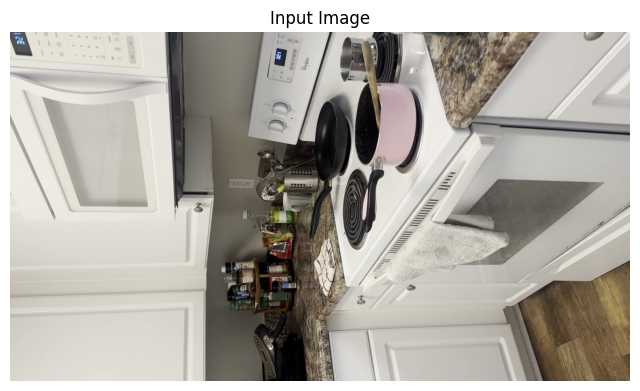


Processing frame: frame_00265.jpg
No detections in frame_00265.jpg, skipping.

Processing frame: frame_00270.jpg
No detections in frame_00270.jpg, skipping.

Processing frame: frame_00275.jpg
No detections in frame_00275.jpg, skipping.

Processing frame: frame_00280.jpg
No detections in frame_00280.jpg, skipping.

Processing frame: frame_00285.jpg
Boxes shape: (2, 4) Labels shape: (2,) Scores shape: (2,)
Error processing frame_00285.jpg: 'label'

Processing frame: frame_00290.jpg
No detections in frame_00290.jpg, skipping.

Processing frame: frame_00295.jpg
No detections in frame_00295.jpg, skipping.

Processing frame: frame_00300.jpg
No detections in frame_00300.jpg, skipping.

Processing frame: frame_00305.jpg
No detections in frame_00305.jpg, skipping.

Processing frame: frame_00310.jpg
No detections in frame_00310.jpg, skipping.

Processing frame: frame_00315.jpg
Boxes shape: (1, 4) Labels shape: (1,) Scores shape: (1,)


<Figure size 1200x800 with 0 Axes>

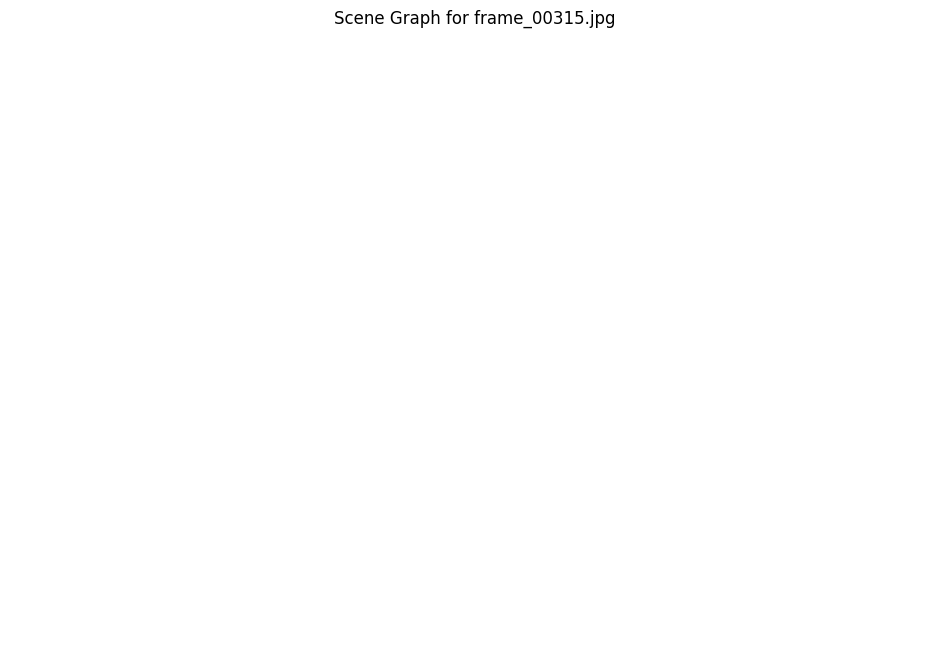

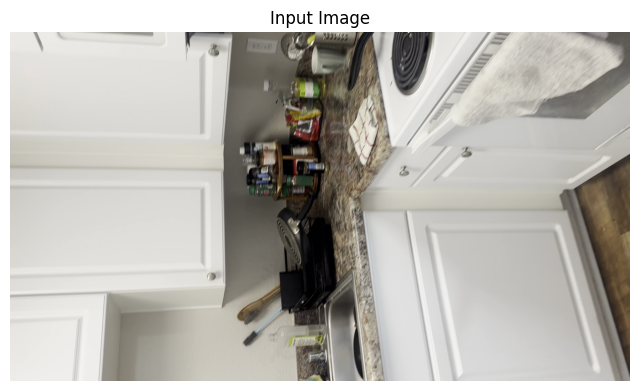


Processing frame: frame_00320.jpg
Boxes shape: (1, 4) Labels shape: (1,) Scores shape: (1,)


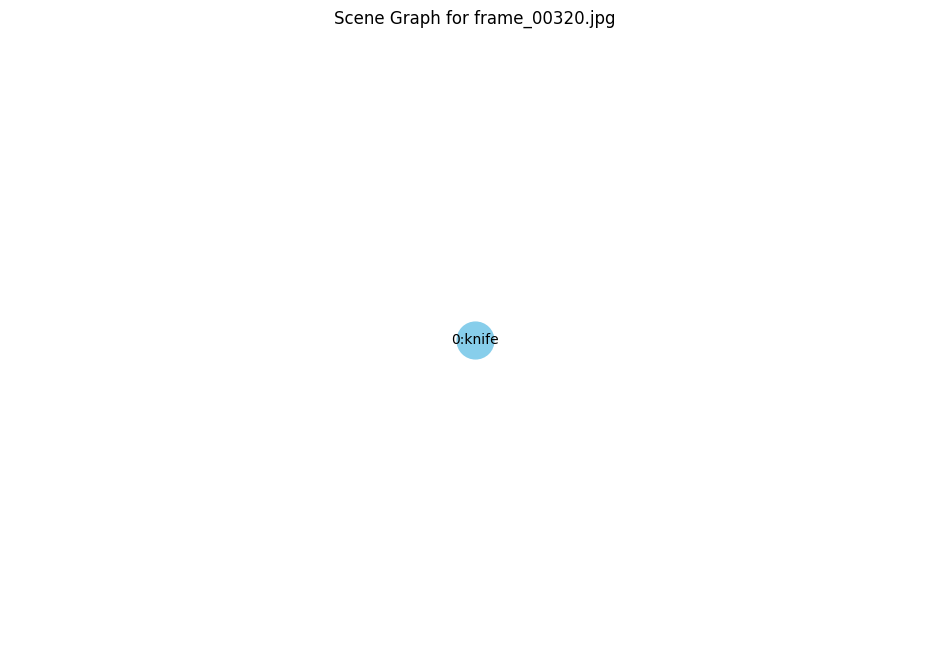

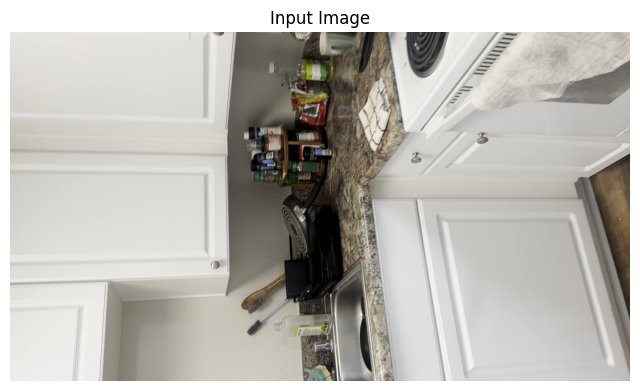


Processing frame: frame_00325.jpg
No detections in frame_00325.jpg, skipping.

Processing frame: frame_00330.jpg
No detections in frame_00330.jpg, skipping.

Processing frame: frame_00335.jpg
No detections in frame_00335.jpg, skipping.

Processing frame: frame_00340.jpg
Boxes shape: (1, 4) Labels shape: (1,) Scores shape: (1,)


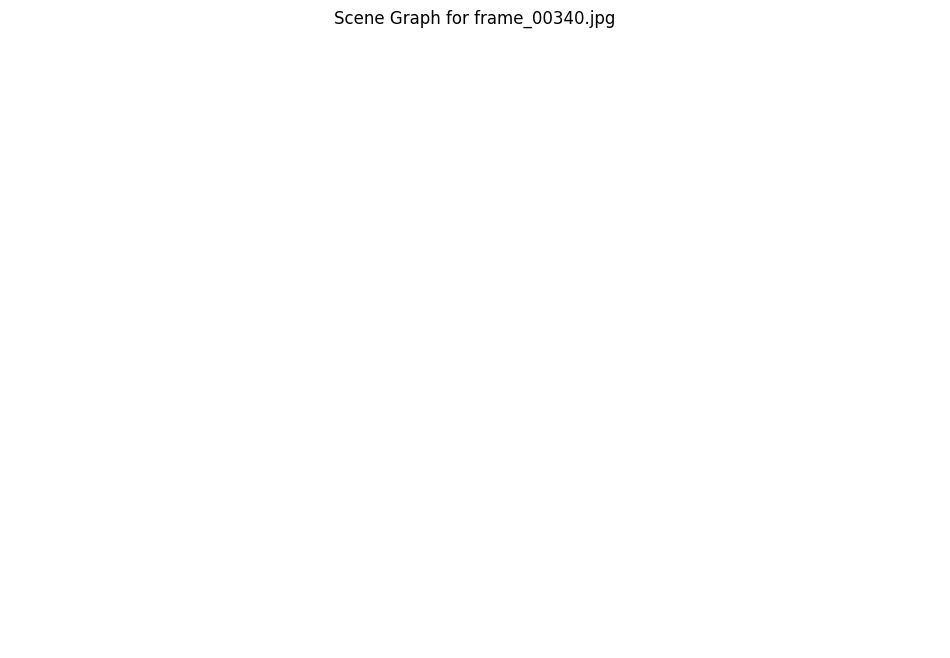

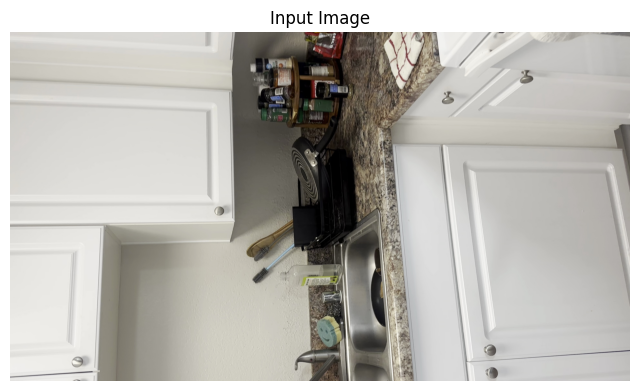


Processing frame: frame_00345.jpg
No detections in frame_00345.jpg, skipping.

Processing frame: frame_00350.jpg
No detections in frame_00350.jpg, skipping.

Processing frame: frame_00355.jpg
No detections in frame_00355.jpg, skipping.

Processing frame: frame_00360.jpg
No detections in frame_00360.jpg, skipping.

Processing frame: frame_00365.jpg
Boxes shape: (1, 4) Labels shape: (1,) Scores shape: (1,)


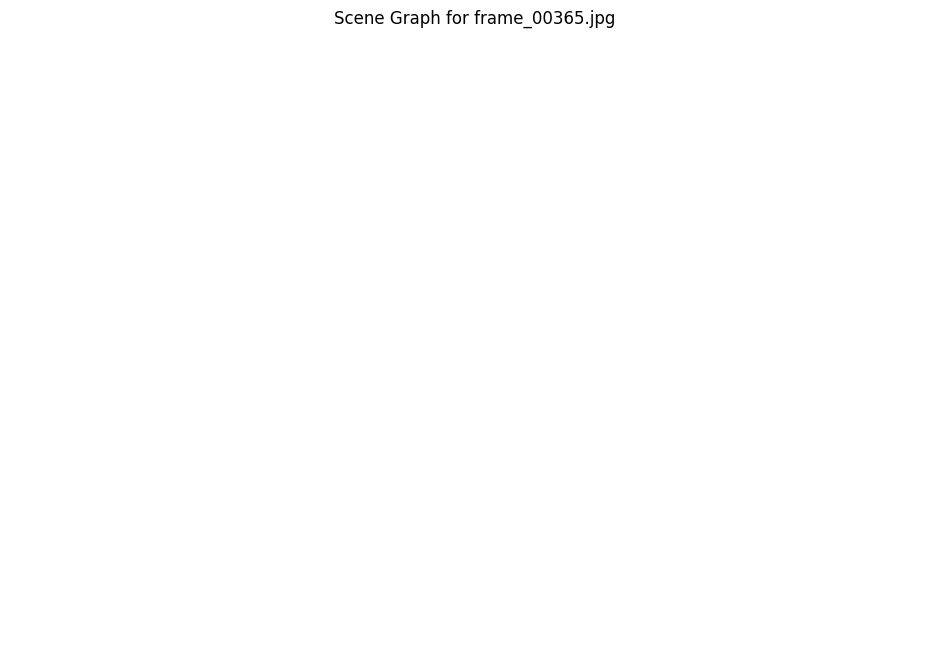

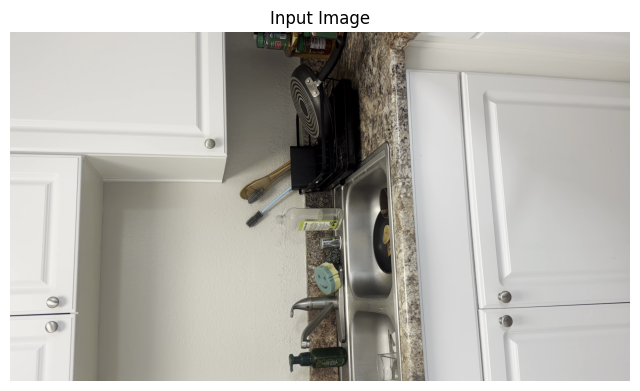


Processing frame: frame_00370.jpg
No detections in frame_00370.jpg, skipping.

Processing frame: frame_00375.jpg
No detections in frame_00375.jpg, skipping.

Processing frame: frame_00380.jpg
No detections in frame_00380.jpg, skipping.

Processing frame: frame_00385.jpg
No detections in frame_00385.jpg, skipping.

Processing frame: frame_00390.jpg
No detections in frame_00390.jpg, skipping.

Processing frame: frame_00395.jpg
No detections in frame_00395.jpg, skipping.

Processing frame: frame_00400.jpg
No detections in frame_00400.jpg, skipping.

Processing frame: frame_00405.jpg
No detections in frame_00405.jpg, skipping.

Processing frame: frame_00410.jpg
No detections in frame_00410.jpg, skipping.

Processing frame: frame_00415.jpg
Boxes shape: (1, 4) Labels shape: (1,) Scores shape: (1,)


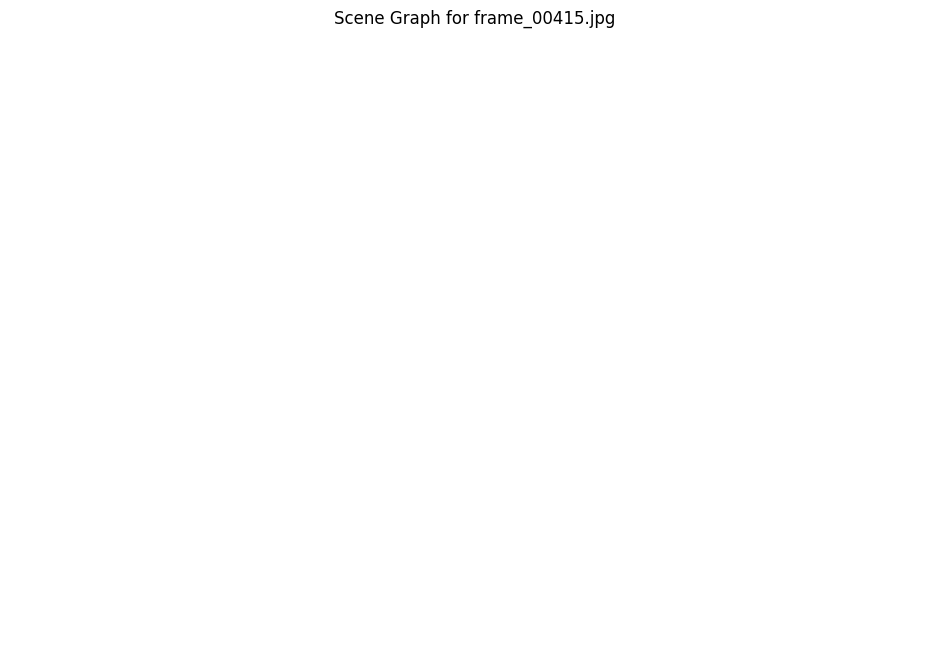

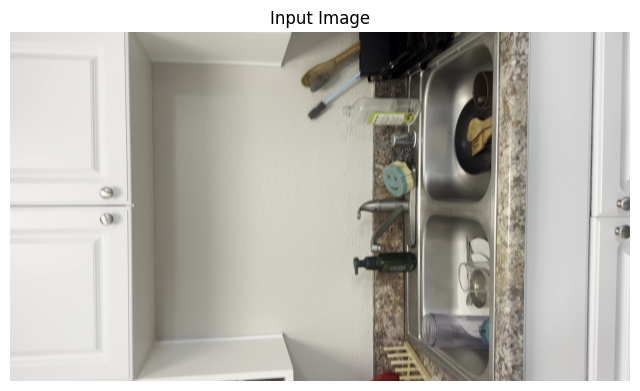


Processing frame: frame_00420.jpg
No detections in frame_00420.jpg, skipping.

Processing frame: frame_00425.jpg
No detections in frame_00425.jpg, skipping.

Processing frame: frame_00430.jpg
No detections in frame_00430.jpg, skipping.

Processing frame: frame_00435.jpg
Boxes shape: (1, 4) Labels shape: (1,) Scores shape: (1,)


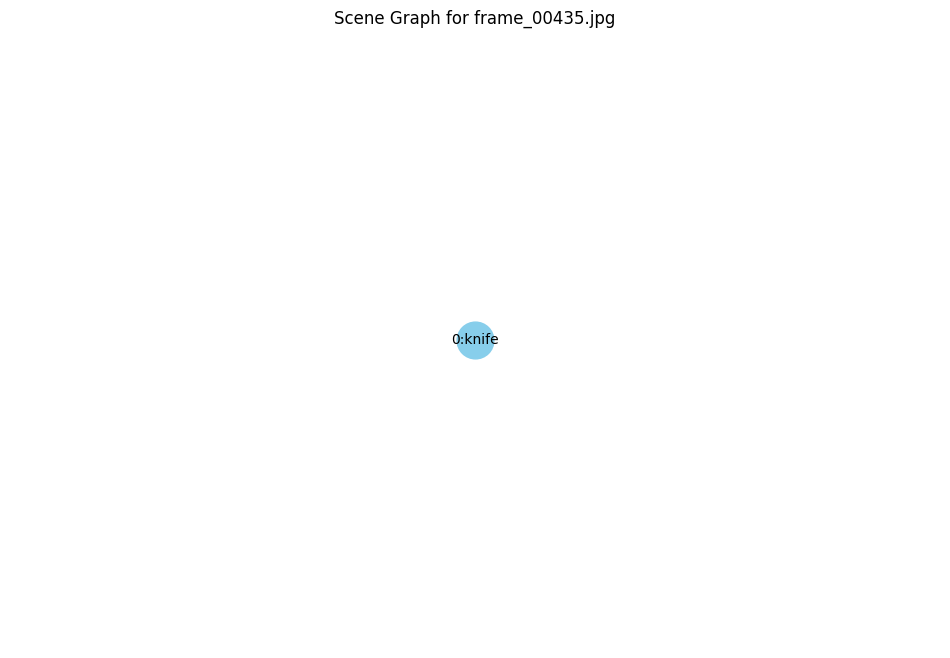

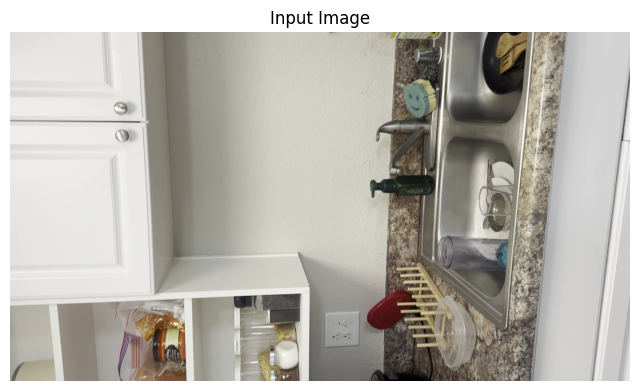


Processing frame: frame_00440.jpg
No detections in frame_00440.jpg, skipping.

Processing frame: frame_00445.jpg
Boxes shape: (1, 4) Labels shape: (1,) Scores shape: (1,)


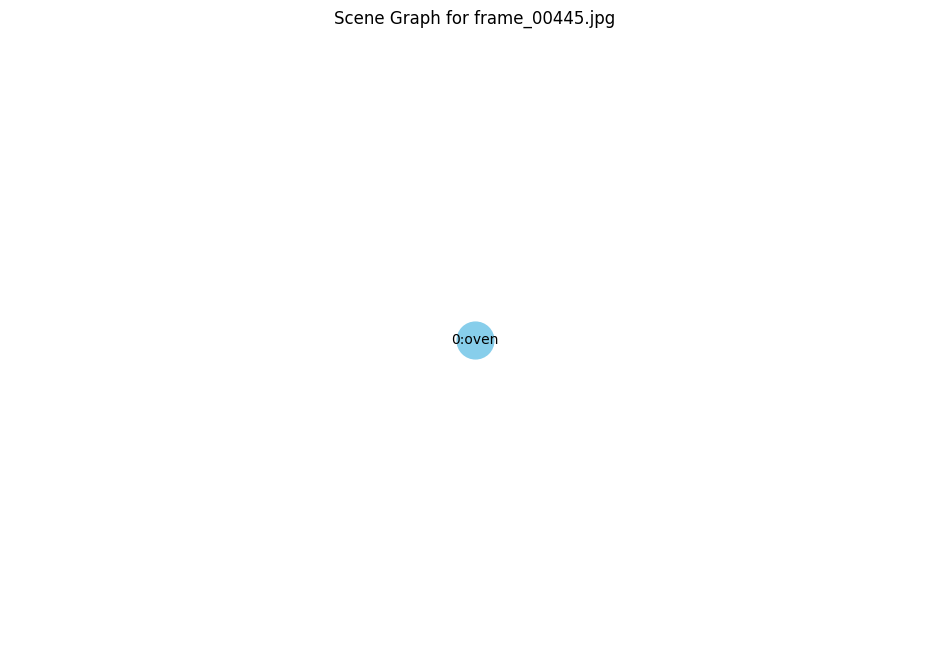

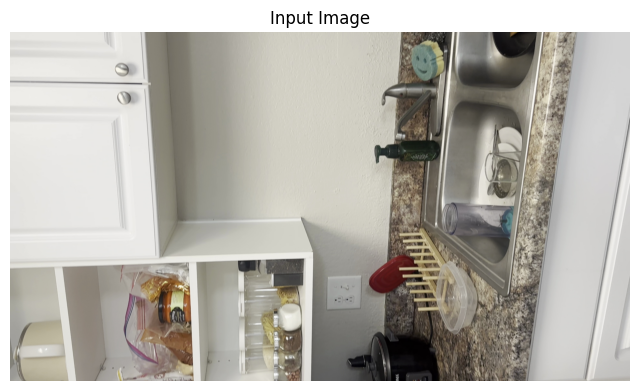


Processing frame: frame_00450.jpg
No detections in frame_00450.jpg, skipping.

Processing frame: frame_00455.jpg
No detections in frame_00455.jpg, skipping.

Processing frame: frame_00460.jpg
No detections in frame_00460.jpg, skipping.

Processing frame: frame_00465.jpg
No detections in frame_00465.jpg, skipping.

Processing frame: frame_00470.jpg
No detections in frame_00470.jpg, skipping.

Processing frame: frame_00475.jpg
No detections in frame_00475.jpg, skipping.

Processing frame: frame_00480.jpg
No detections in frame_00480.jpg, skipping.

Processing frame: frame_00485.jpg
No detections in frame_00485.jpg, skipping.

Processing frame: frame_00490.jpg
No detections in frame_00490.jpg, skipping.

Processing frame: frame_00495.jpg
No detections in frame_00495.jpg, skipping.

Processing frame: frame_00500.jpg
No detections in frame_00500.jpg, skipping.

Processing frame: frame_00505.jpg
No detections in frame_00505.jpg, skipping.

Processing frame: frame_00510.jpg
No detections in 

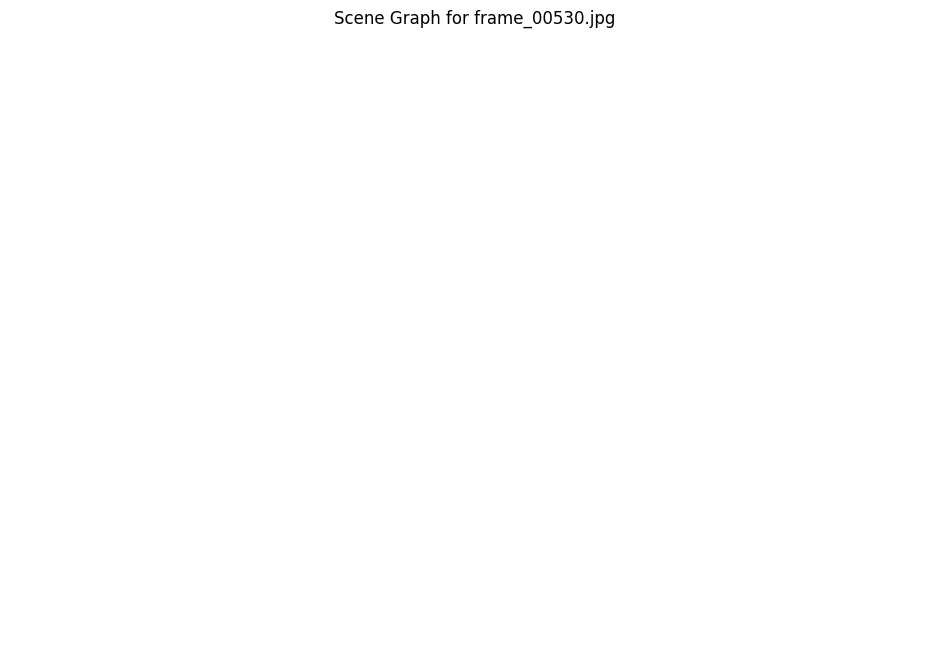

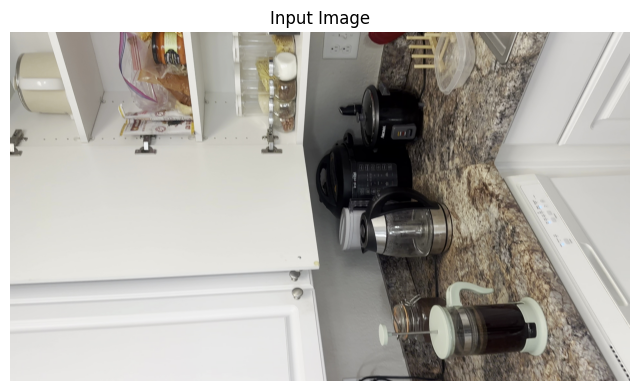


Processing frame: frame_00535.jpg
No detections in frame_00535.jpg, skipping.

Processing frame: frame_00540.jpg
No detections in frame_00540.jpg, skipping.

Processing frame: frame_00545.jpg
No detections in frame_00545.jpg, skipping.

Processing frame: frame_00550.jpg
No detections in frame_00550.jpg, skipping.

Processing frame: frame_00555.jpg
No detections in frame_00555.jpg, skipping.

Processing frame: frame_00560.jpg
No detections in frame_00560.jpg, skipping.

Processing frame: frame_00565.jpg
No detections in frame_00565.jpg, skipping.

Processing frame: frame_00570.jpg
No detections in frame_00570.jpg, skipping.

Processing frame: frame_00575.jpg
No detections in frame_00575.jpg, skipping.

Processing frame: frame_00580.jpg
No detections in frame_00580.jpg, skipping.

Processing frame: frame_00585.jpg
No detections in frame_00585.jpg, skipping.

Processing frame: frame_00590.jpg
No detections in frame_00590.jpg, skipping.

Processing frame: frame_00595.jpg
No detections in 

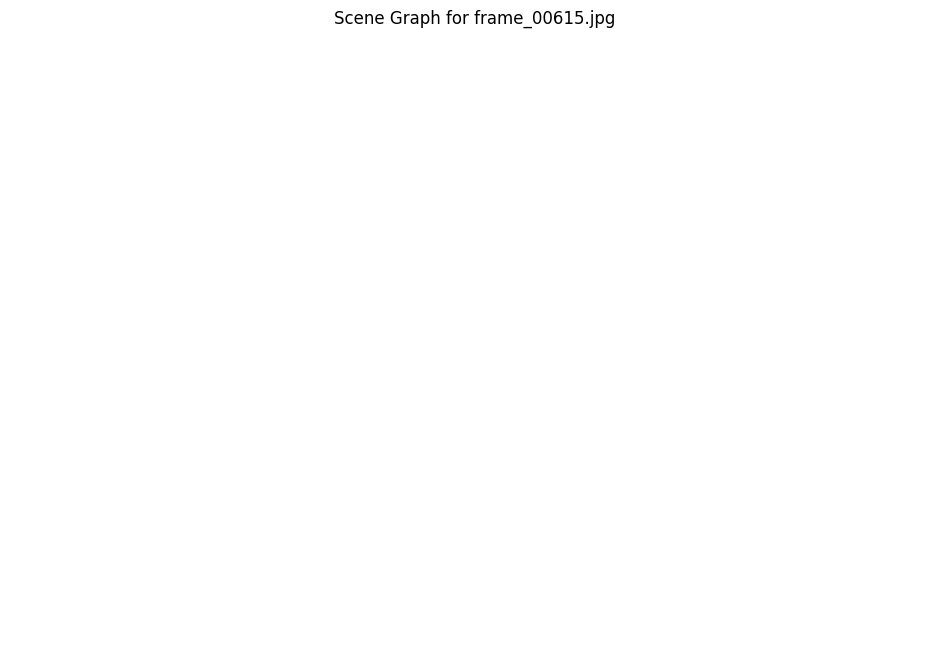

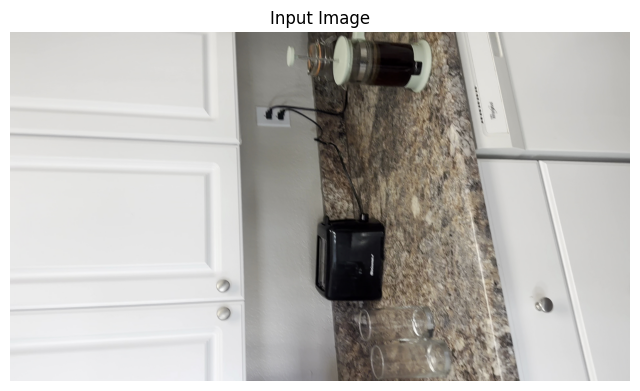


Processing frame: frame_00620.jpg
Boxes shape: (1, 4) Labels shape: (1,) Scores shape: (1,)


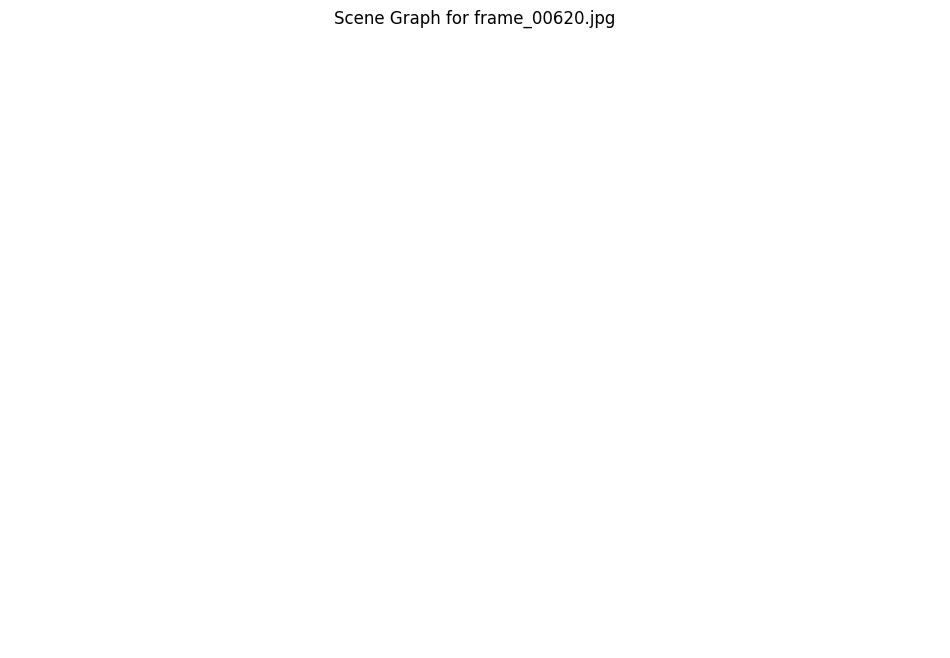

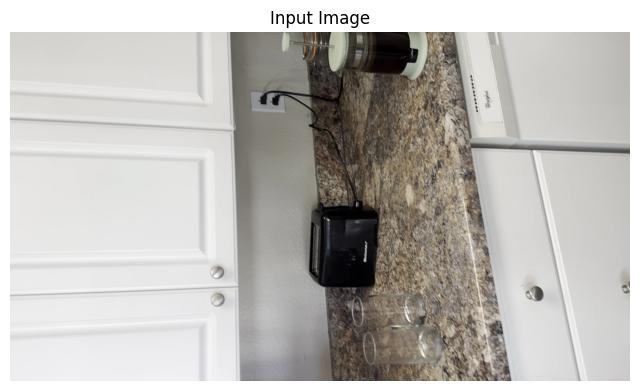


Processing frame: frame_00625.jpg
No detections in frame_00625.jpg, skipping.

Processing frame: frame_00630.jpg
Boxes shape: (2, 4) Labels shape: (2,) Scores shape: (2,)
Error processing frame_00630.jpg: 'label'

Processing frame: frame_00635.jpg
Boxes shape: (1, 4) Labels shape: (1,) Scores shape: (1,)


<Figure size 1200x800 with 0 Axes>

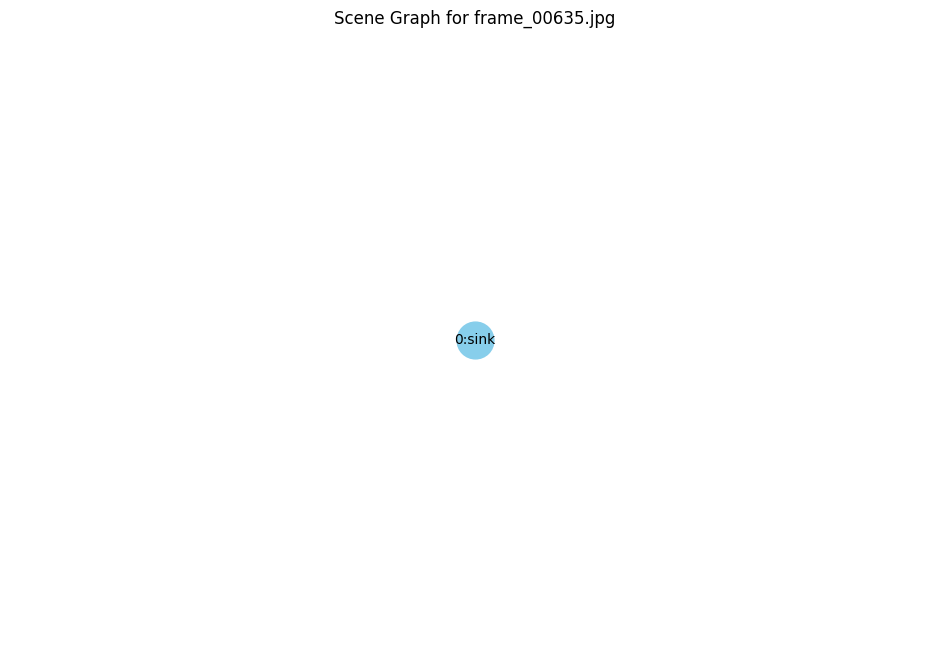

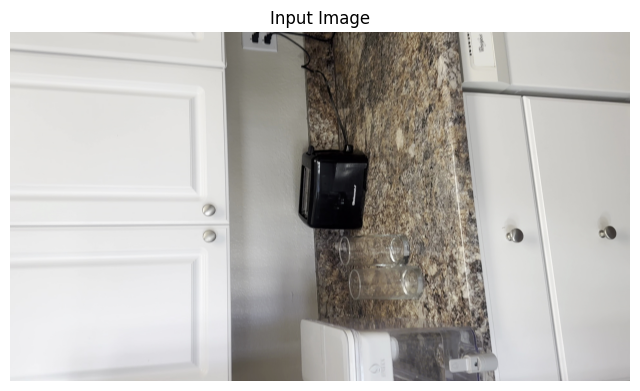


Processing frame: frame_00640.jpg
Boxes shape: (3, 4) Labels shape: (3,) Scores shape: (3,)
Error processing frame_00640.jpg: 'label'

Processing frame: frame_00645.jpg
Boxes shape: (3, 4) Labels shape: (3,) Scores shape: (3,)
Error processing frame_00645.jpg: 'label'

Processing frame: frame_00650.jpg
Boxes shape: (2, 4) Labels shape: (2,) Scores shape: (2,)
Error processing frame_00650.jpg: 'label'

Processing frame: frame_00655.jpg
No detections in frame_00655.jpg, skipping.

Processing frame: frame_00660.jpg
Boxes shape: (1, 4) Labels shape: (1,) Scores shape: (1,)


<Figure size 1200x800 with 0 Axes>

<Figure size 1200x800 with 0 Axes>

<Figure size 1200x800 with 0 Axes>

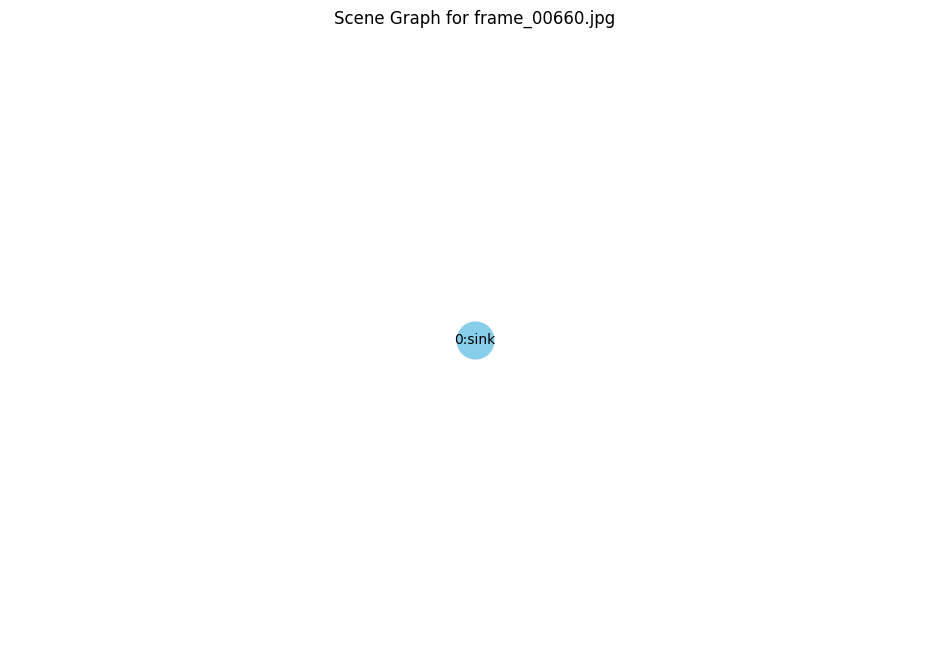

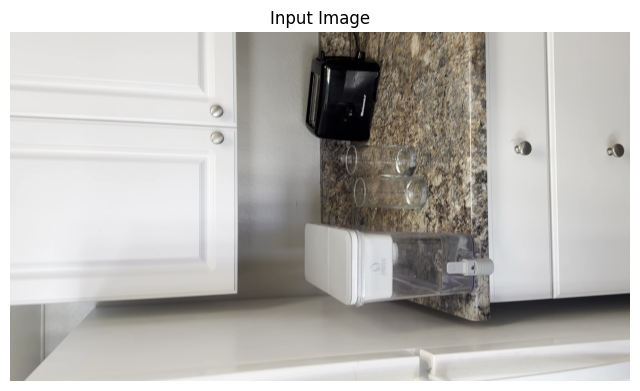


Processing frame: frame_00665.jpg
No detections in frame_00665.jpg, skipping.

Processing frame: frame_00670.jpg
No detections in frame_00670.jpg, skipping.

Processing frame: frame_00675.jpg
Boxes shape: (1, 4) Labels shape: (1,) Scores shape: (1,)


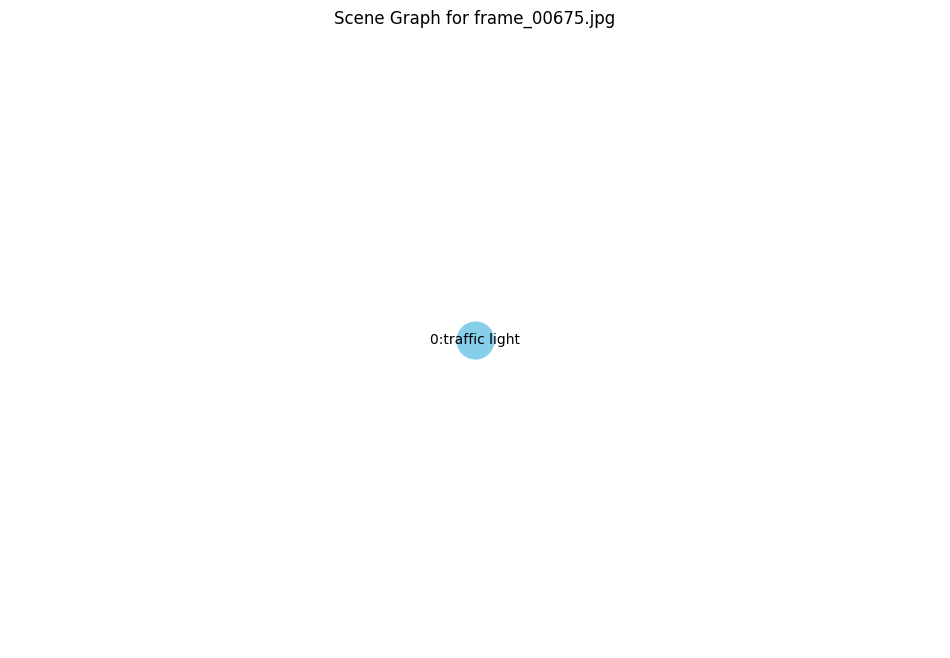

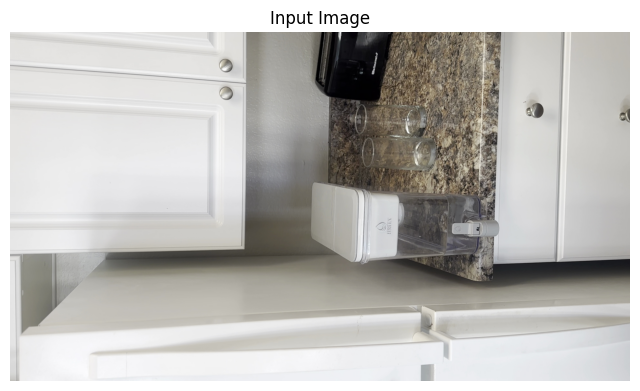


Processing frame: frame_00680.jpg
Boxes shape: (1, 4) Labels shape: (1,) Scores shape: (1,)


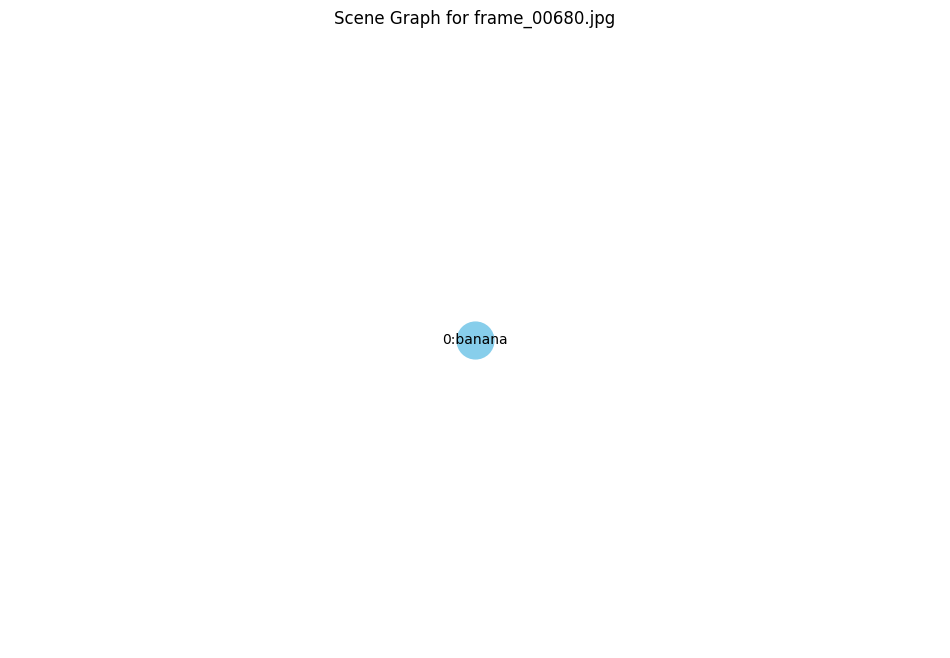

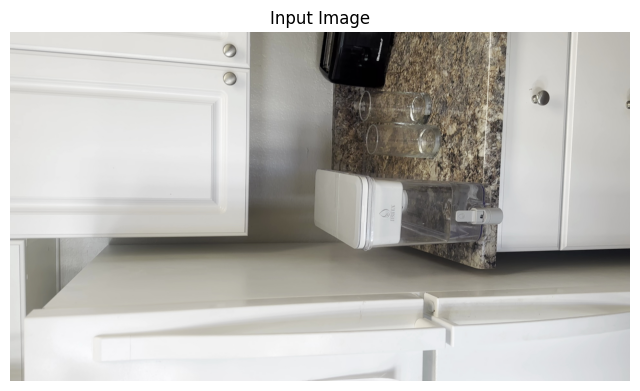


Processing frame: frame_00685.jpg
Boxes shape: (1, 4) Labels shape: (1,) Scores shape: (1,)


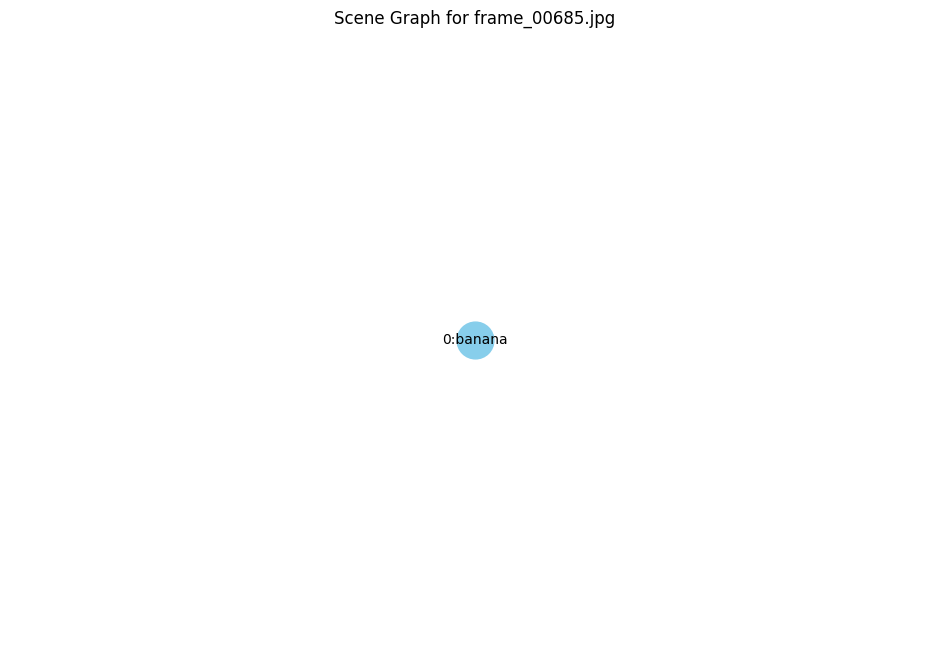

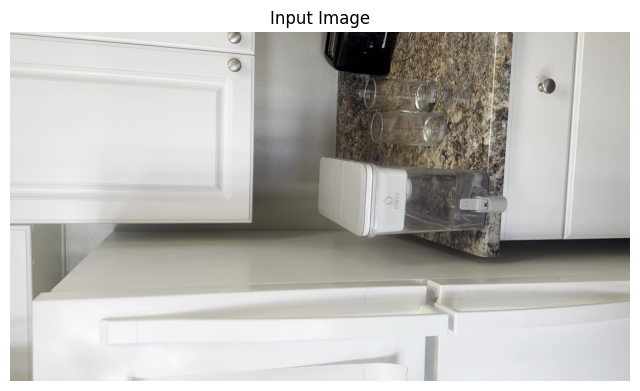


Processing frame: frame_00690.jpg
No detections in frame_00690.jpg, skipping.

Processing frame: frame_00695.jpg
No detections in frame_00695.jpg, skipping.

Processing frame: frame_00700.jpg
Boxes shape: (1, 4) Labels shape: (1,) Scores shape: (1,)


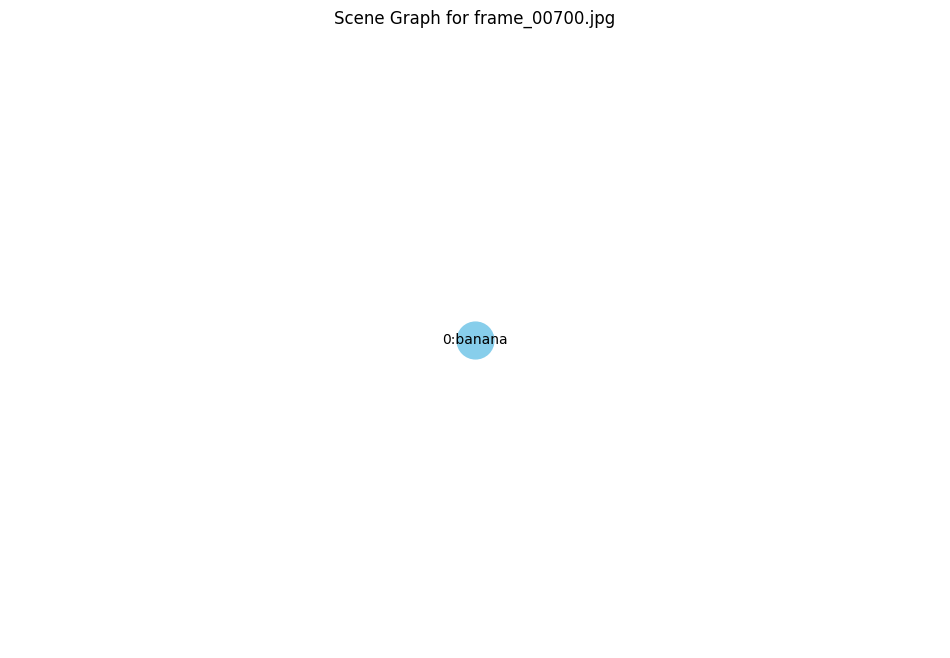

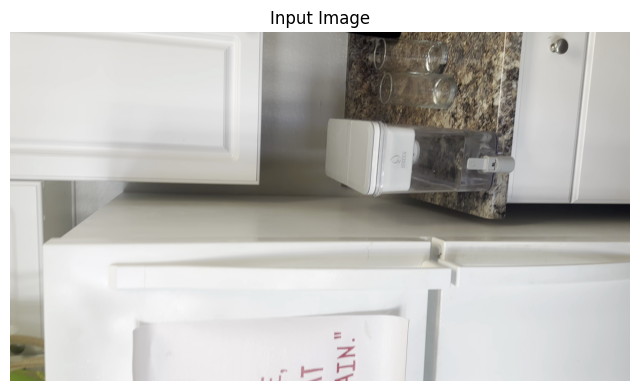


Processing frame: frame_00705.jpg
No detections in frame_00705.jpg, skipping.

Processing frame: frame_00710.jpg
Boxes shape: (1, 4) Labels shape: (1,) Scores shape: (1,)


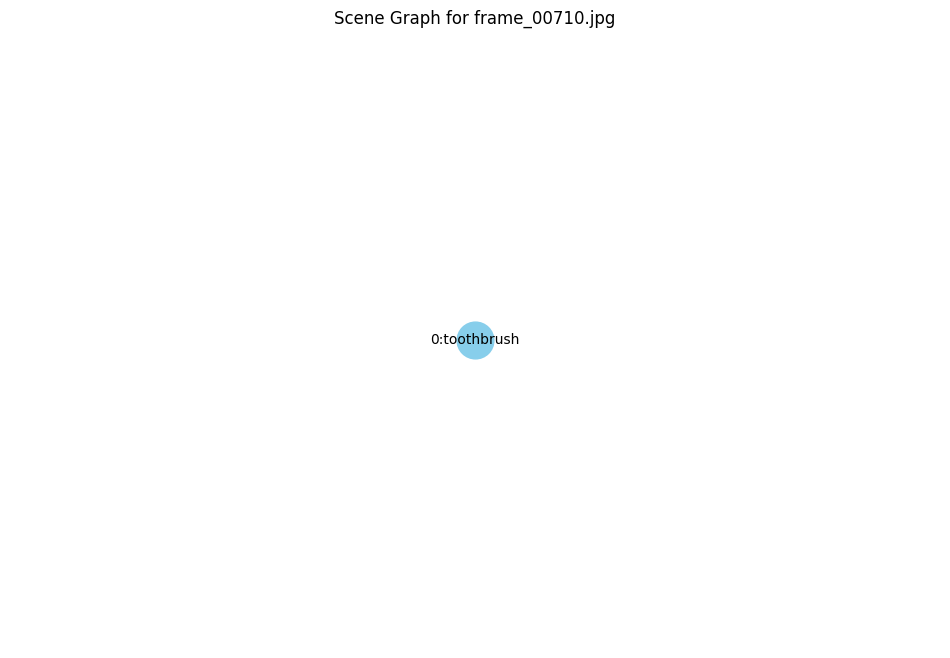

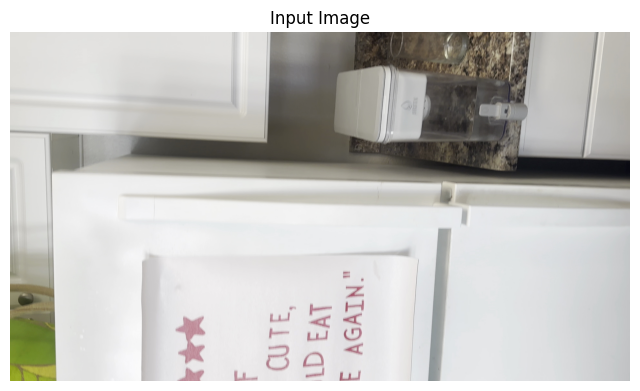


Processing frame: frame_00715.jpg
No detections in frame_00715.jpg, skipping.

Processing frame: frame_00720.jpg
No detections in frame_00720.jpg, skipping.

Processing frame: frame_00725.jpg
No detections in frame_00725.jpg, skipping.

Processing frame: frame_00730.jpg
No detections in frame_00730.jpg, skipping.

Processing frame: frame_00735.jpg
No detections in frame_00735.jpg, skipping.

Processing frame: frame_00740.jpg
No detections in frame_00740.jpg, skipping.

Processing frame: frame_00745.jpg
No detections in frame_00745.jpg, skipping.

Processing frame: frame_00750.jpg
No detections in frame_00750.jpg, skipping.

Processing frame: frame_00755.jpg
No detections in frame_00755.jpg, skipping.

Processing frame: frame_00760.jpg
No detections in frame_00760.jpg, skipping.

Processing frame: frame_00765.jpg
No detections in frame_00765.jpg, skipping.

Processing frame: frame_00770.jpg
No detections in frame_00770.jpg, skipping.

Processing frame: frame_00775.jpg
No detections in 

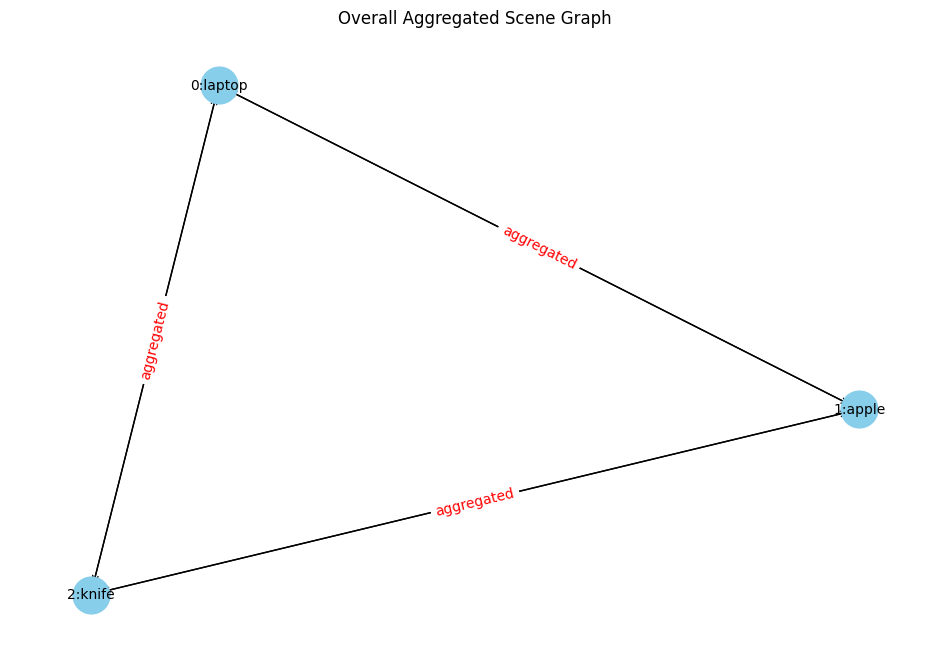

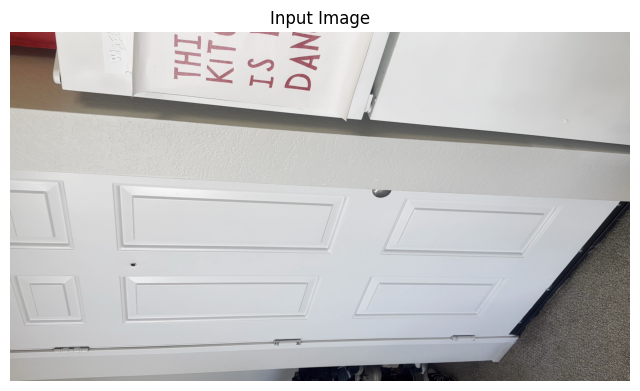

In [13]:
per_frame_graphs = []

frame_files = sorted([f for f in os.listdir(FRAMES_DIR) if f.endswith(".jpg")])
for frame_file in frame_files:
    frame_path = os.path.join(FRAMES_DIR, frame_file)
    print(f"\nProcessing frame: {frame_file}")
    try:
        # Load image (PIL for ROI/visualization).
        image_pil = Image.open(frame_path).convert("RGB")
        # Preprocess image for detection.
        image_tensor = transform(image_pil).unsqueeze(0).to(device)
        
        # Run object detection.
        boxes, labels, scores = detect_objects(image_tensor, score_thresh=0.8)
        
        # Convert detections to NumPy arrays.
        boxes = np.array(boxes)
        labels = np.array(labels)
        scores = np.array(scores)
        
        # Ensure boxes are 2D.
        if boxes.ndim == 1:
            if boxes.size == 4:
                boxes = boxes.reshape(1,4)
            else:
                raise ValueError(f"Unexpected boxes shape: {boxes.shape}")
        if labels.ndim == 0:
            labels = labels.reshape(1)
        if scores.ndim == 0:
            scores = scores.reshape(1)
        
        # If no detections, skip this frame.
        if boxes.shape[0] == 0:
            print(f"No detections in {frame_file}, skipping.")
            continue
        
        print("Boxes shape:", boxes.shape, "Labels shape:", labels.shape, "Scores shape:", scores.shape)
        
        # Prepare detections for the centroid tracker.
        # Convert boxes from [x1, y1, x2, y2] to [x, y, w, h].
        detections_for_tracker = []
        for box, label in zip(boxes, labels):
            x1, y1, x2, y2 = box
            w = x2 - x1
            h = y2 - y1
            detections_for_tracker.append(([x1, y1, w, h], int(label)))
        
        # Update centroid tracker.
        tracked_objects = centroid_tracker.update(detections_for_tracker)
        # (For this demo, we use the raw detection outputs for scene graph construction.)
        
        # Extract ROI features.
        features = get_backbone_features(image_tensor)
        region_features = extract_region_features(image_tensor, boxes, features, output_size=(7,7))
        
        # Define relationship classes.
        relation_classes = ["no_relation", "on", "next_to", "under", "holding", "riding"]
        # For ROI features: feature_dim = 7*7*256.
        feature_dim = 7 * 7 * 256
        
        # Instantiate the relationship predictor if not already done.
        # (Ensure this cell is run before the pipeline cell if defined earlier.)
        try:
            relationship_predictor
        except NameError:
            relationship_predictor = RelationshipPredictor(feature_dim, hidden_dim=512, num_relations=len(relation_classes))
            relationship_predictor.to(device)
            relationship_predictor.eval()  # Untrained
        
        # Predict relationships.
        relationships_list = predict_relationships(region_features, relationship_predictor, relation_classes)
        
        # Build per-frame scene graph.
        G_frame = build_scene_graph(boxes, labels, scores, relationships_list, coco_classes)
        per_frame_graphs.append(G_frame)
        
        # Visualize per-frame scene graph.
        visualize_scene_graph(G_frame, image_pil, title=f"Scene Graph for {frame_file}")
    except Exception as e:
        print(f"Error processing {frame_file}: {e}")

# Aggregate per-frame graphs into an overall scene graph.
if per_frame_graphs:
    overall_graph = aggregate_scene_graphs(per_frame_graphs)
    visualize_scene_graph(overall_graph, image_pil, title="Overall Aggregated Scene Graph")

just one image testing 

In [ ]:
# %% [markdown]
# ## Test on a Single Image
# 
# This cell loads a test image from the `data/` folder, runs it through the pipeline, and visualizes the resulting scene graph.

# %% [code]
# Specify the path to your test image (make sure it's placed in your data folder).
test_image_path = "/Users/tanishqsingh/Documents/GitHub/scene_graph_advanced/data/test_image.png"

# Load the image using PIL.
test_image = Image.open(test_image_path).convert("RGB")

# Preprocess the image for detection.
test_tensor = transform(test_image).unsqueeze(0).to(device)

# Run object detection.
test_boxes, test_labels, test_scores = detect_objects(test_tensor, score_thresh=0.5)  # you might lower threshold for testing

# Convert detections to NumPy arrays.
test_boxes = np.array(test_boxes)
test_labels = np.array(test_labels)
test_scores = np.array(test_scores)

# Ensure boxes are 2D (if only one detection, reshape to (1, 4)).
if test_boxes.ndim == 1:
    if test_boxes.size == 4:
        test_boxes = test_boxes.reshape(1, 4)
    else:
        raise ValueError(f"Unexpected boxes shape: {test_boxes.shape}")
if test_labels.ndim == 0:
    test_labels = test_labels.reshape(1)
if test_scores.ndim == 0:
    test_scores = test_scores.reshape(1)

# Check if there are any detections.
if test_boxes.shape[0] == 0:
    print("No detections for the test image.")
else:
    # Extract ROI features.
    test_features = get_backbone_features(test_tensor)
    test_region_features = extract_region_features(test_tensor, test_boxes, test_features, output_size=(7,7))
    
    # Predict relationships.
    test_relationships = predict_relationships(test_region_features, relationship_predictor, relation_classes)
    
    # Build the scene graph for the test image.
    test_graph = build_scene_graph(test_boxes, test_labels, test_scores, test_relationships, coco_classes)
    
    # Visualize the scene graph.
    visualize_scene_graph(test_graph, test_image, title="Scene Graph for Test Image")


UnidentifiedImageError: cannot identify image file '/Users/tanishqsingh/Documents/GitHub/scene_graph_advanced/data/test_image.jpg'